In [10]:
# import libraries 
library(ggplot2)
library(tidyverse)
library(ggfortify)
library(ggrepel)
library(factoextra)
library(FactoMineR)

In [11]:
sharks = read.table("datasets/shark_immunity.txt", header = TRUE, sep = "\t")

# change the order the physiological conditions are displayed 
sharks$physiological_condition <- factor(
  sharks$physiological_condition,
  levels = c("Healthy", "Stressed", "Injured", "Infected", "Recovering")
)

# reduces name to just the gene
names(sharks) <- sub("_expression", "", names(sharks))

In [12]:
options(repr.plot.width=8, repr.plot.height=5)

In [13]:
# reduce the gene categories into 2 variables
sharks_genes = sharks %>% 
    pivot_longer(
        cols = starts_with("Gene_"),
        names_to = "gene",
        values_to = "expression"
    )

In [33]:
condition_data = function(data, condition) {
    data[data$physiological_condition==condition, ]
}

cell_data = function(data, cell_type) {
    data[data$immune_cell_type==cell_type, ]
}

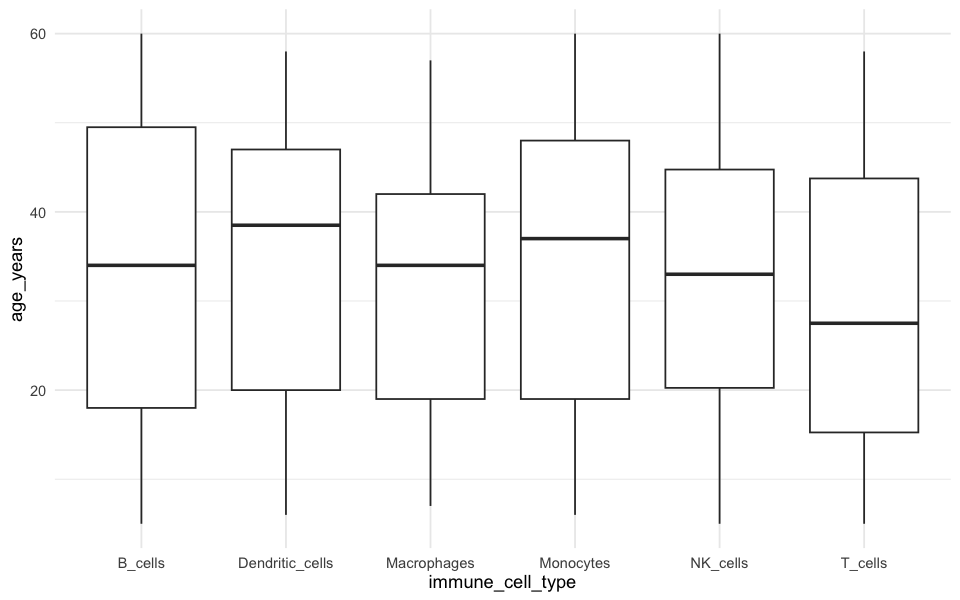

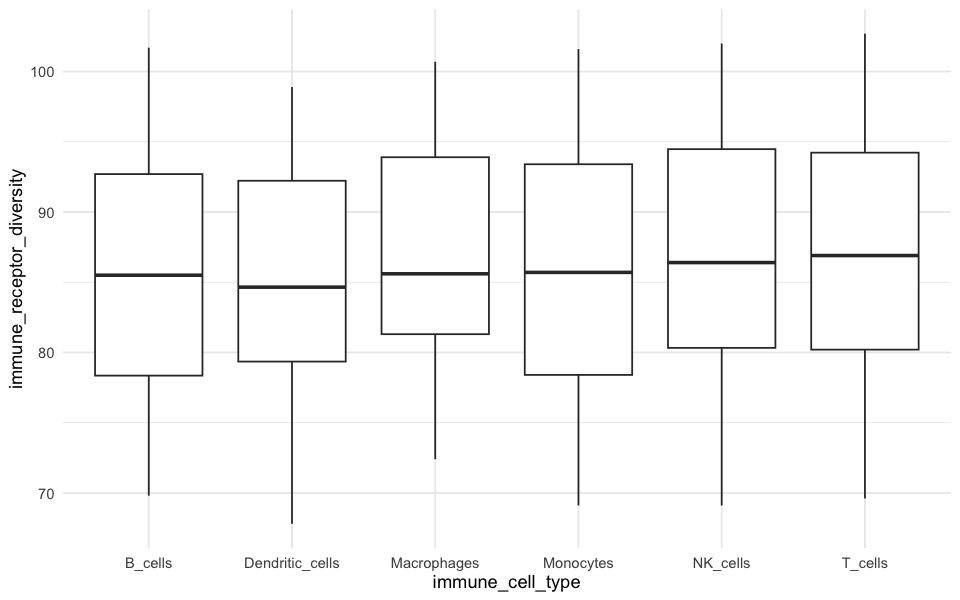

In [34]:
ggplot(condition_data(sharks, "Healthy"), aes(x=immune_cell_type, y=age_years)) +
    geom_boxplot() +
    theme_minimal()

ggplot(condition_data(sharks, "Healthy"), aes(x=immune_cell_type, y=immune_receptor_diversity)) +
    geom_boxplot() +
    theme_minimal()

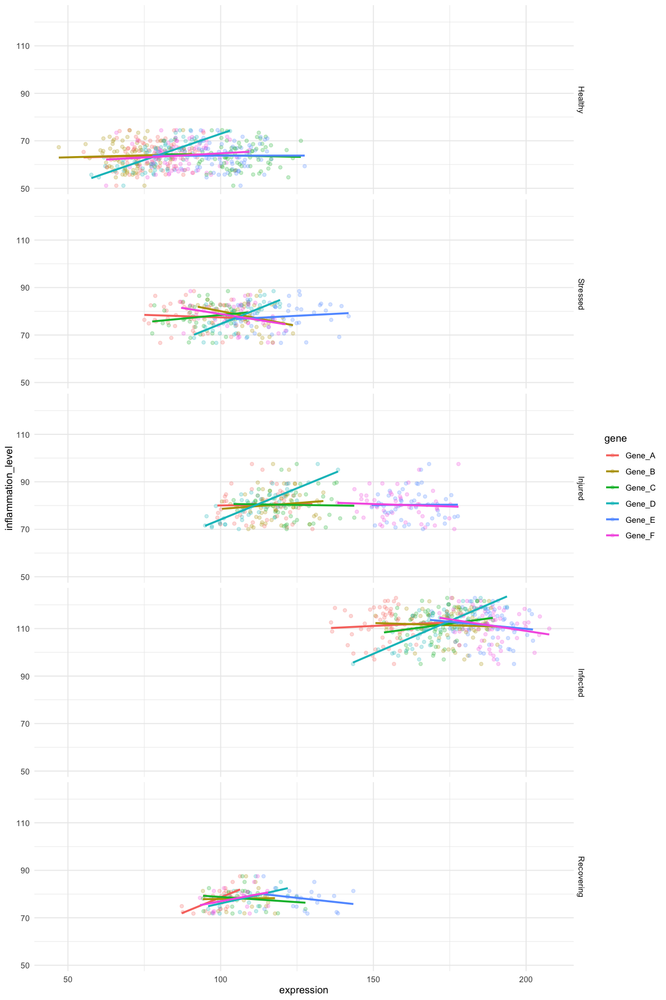

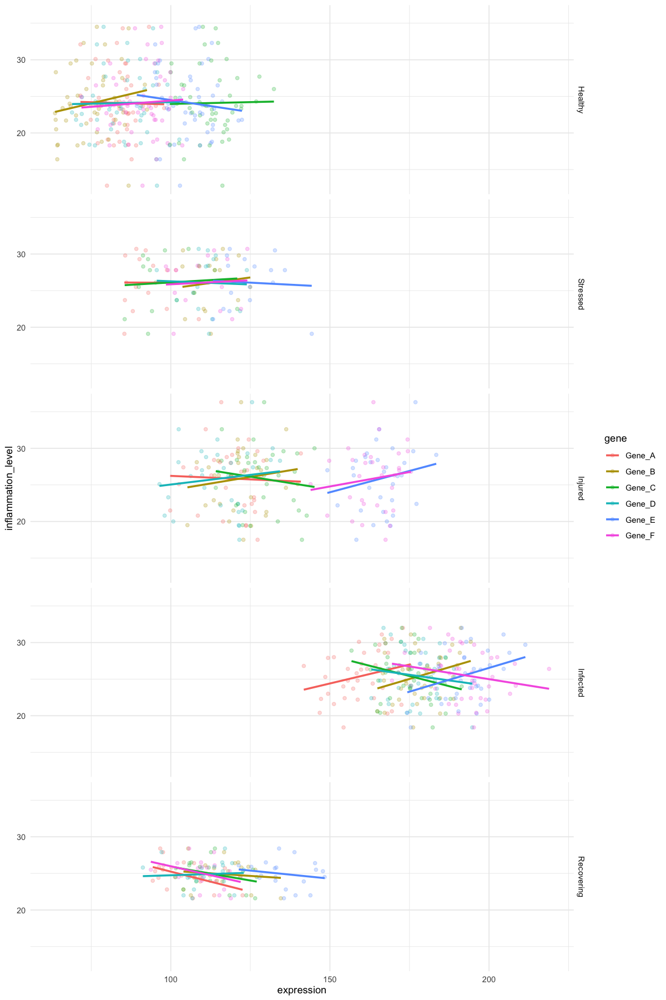

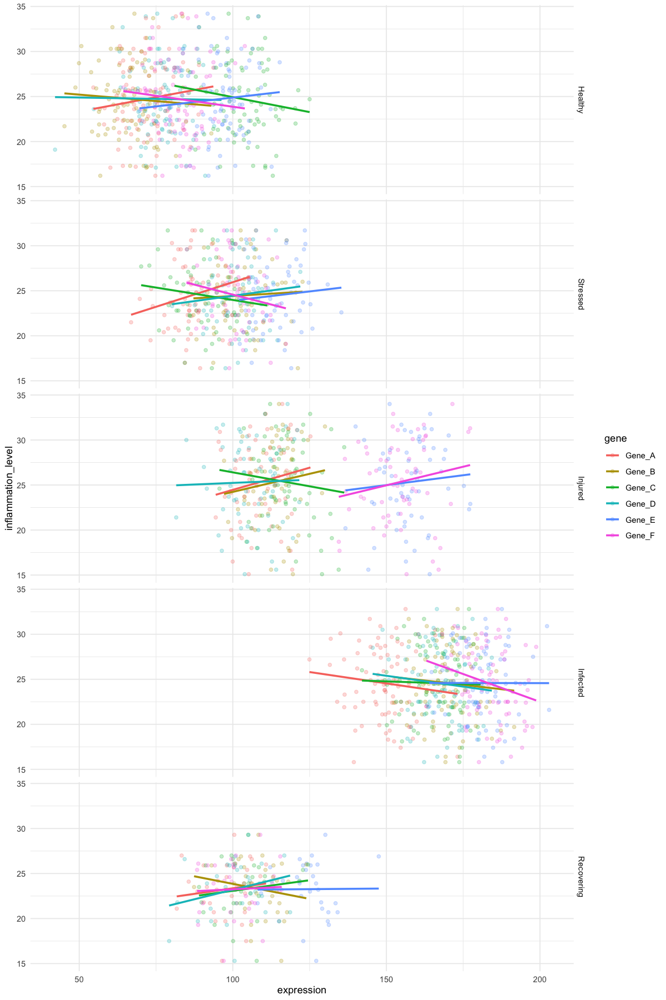

In [74]:
# gene expression + inflammation_level
options(repr.plot.width=10, repr.plot.height=15)

ggplot(cell_data(sharks_genes, "NK_cells"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes, "Dendritic_cells"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

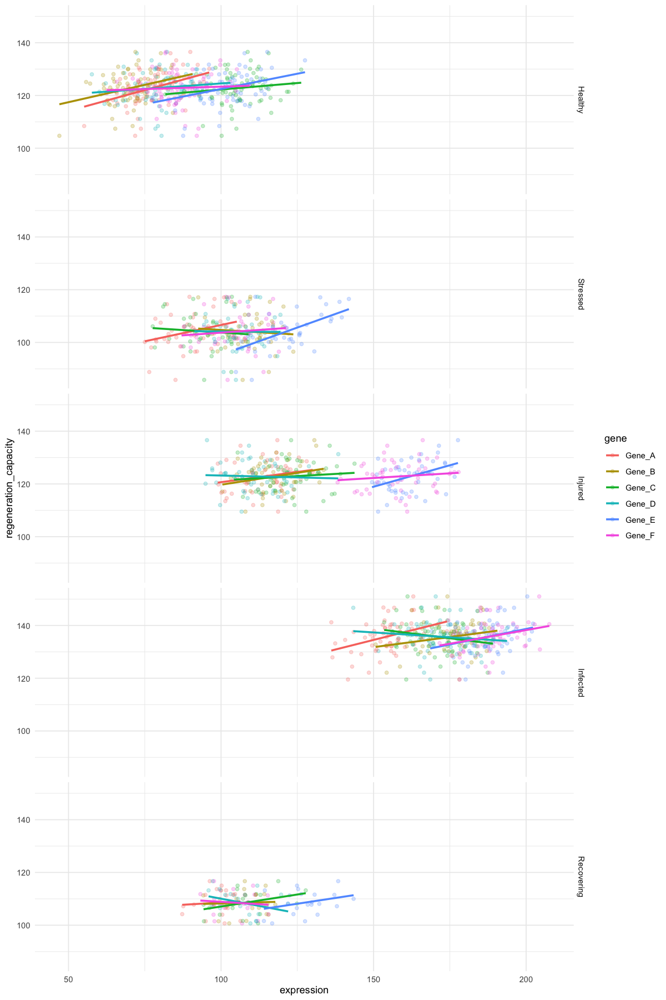

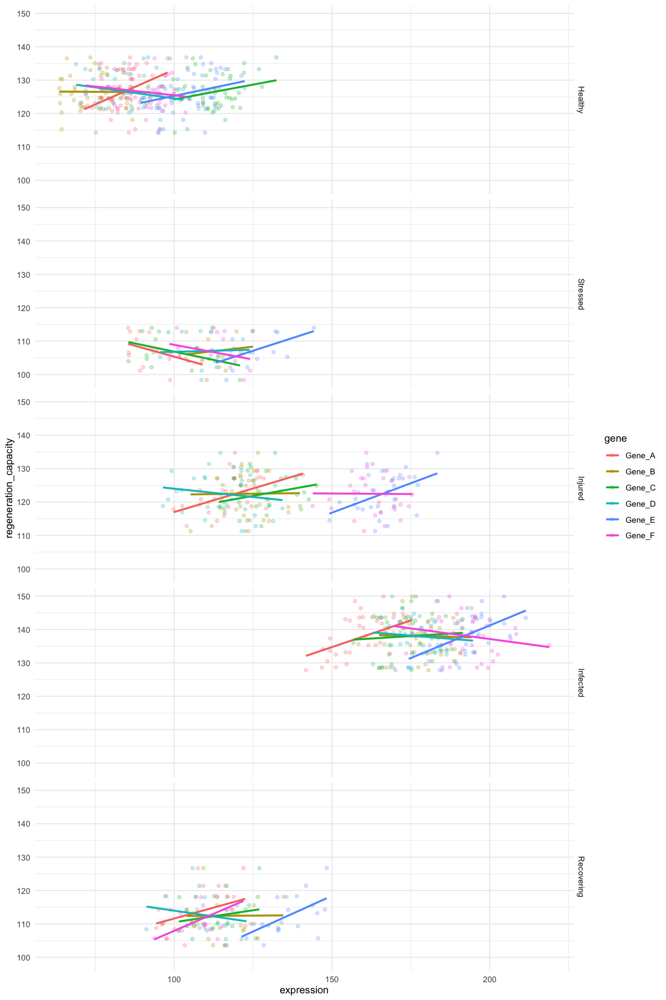

In [75]:
# gene expression + regeneration capacity 

ggplot(cell_data(sharks_genes, "NK_cells"), aes(x=expression, y=regeneration_capacity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes, "Dendritic_cells"), aes(x=expression, y=regeneration_capacity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

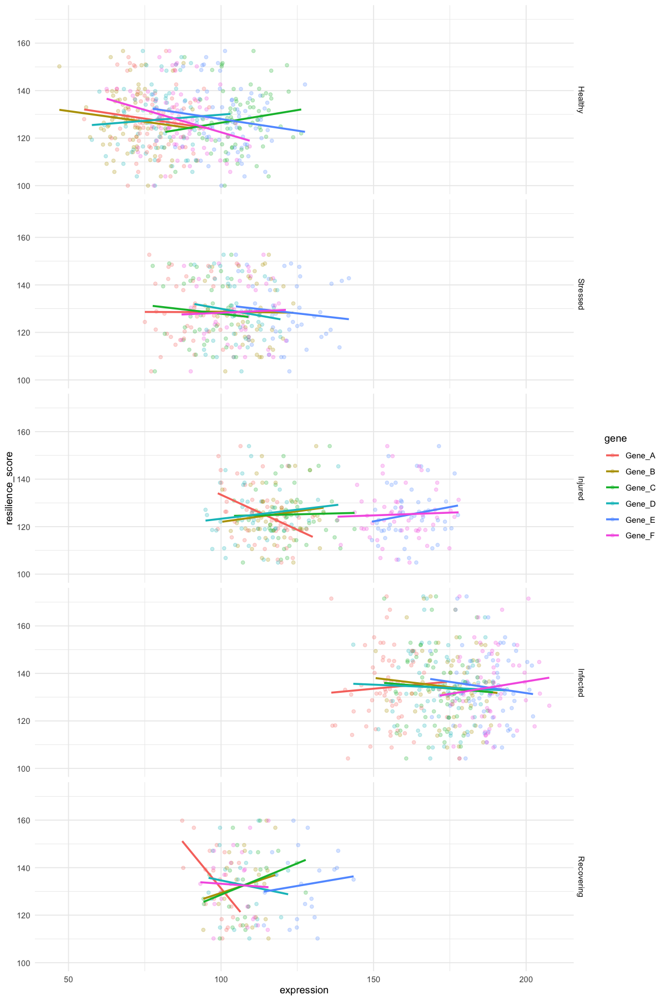

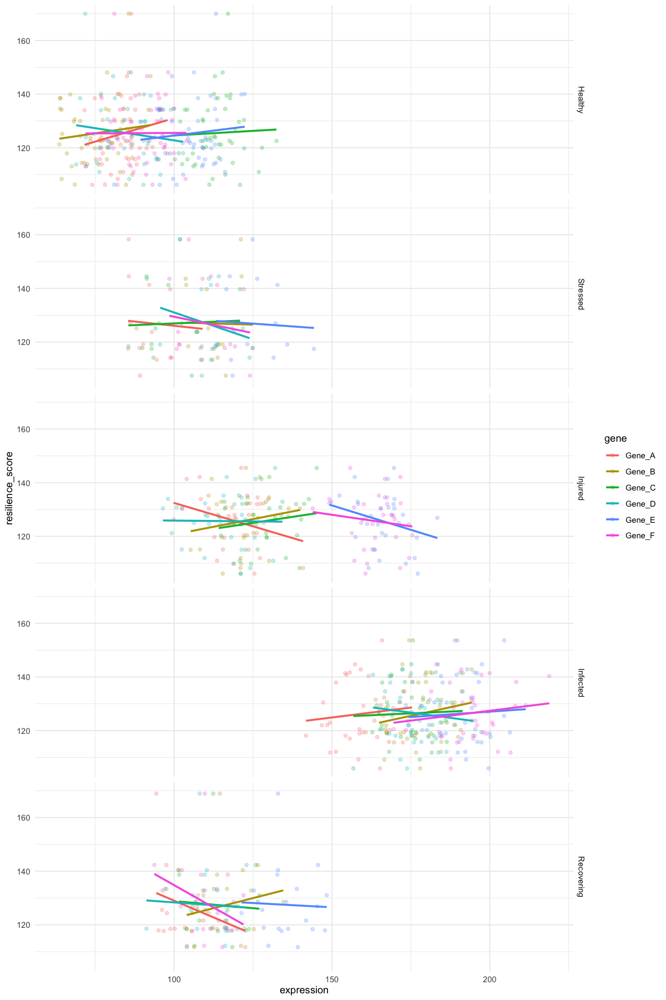

In [76]:
# gene expression + resilience score 

ggplot(cell_data(sharks_genes, "NK_cells"), aes(x=expression, y=resilience_score, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes, "Dendritic_cells"), aes(x=expression, y=resilience_score, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

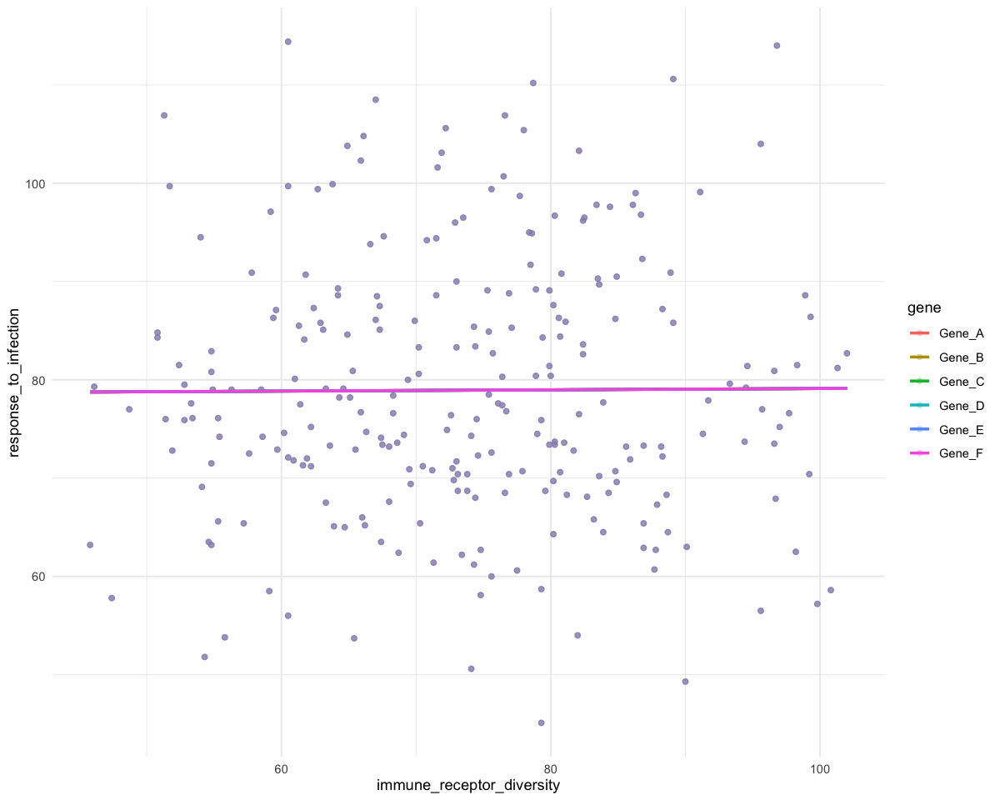

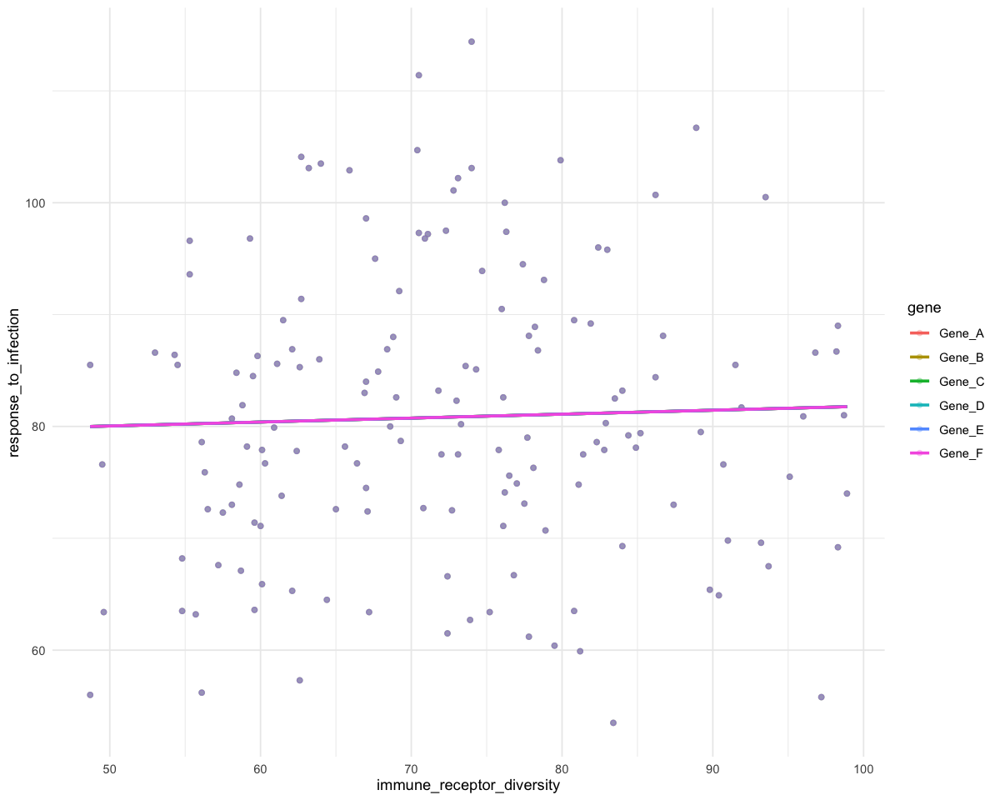

In [85]:
# immune receptor diversity + response to infection
options(repr.plot.width=10, repr.plot.height=8)

ggplot(cell_data(sharks_genes, "NK_cells"), aes(x=immune_receptor_diversity, y=response_to_infection, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(cell_data(sharks_genes, "Dendritic_cells"), aes(x=immune_receptor_diversity, y=response_to_infection, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

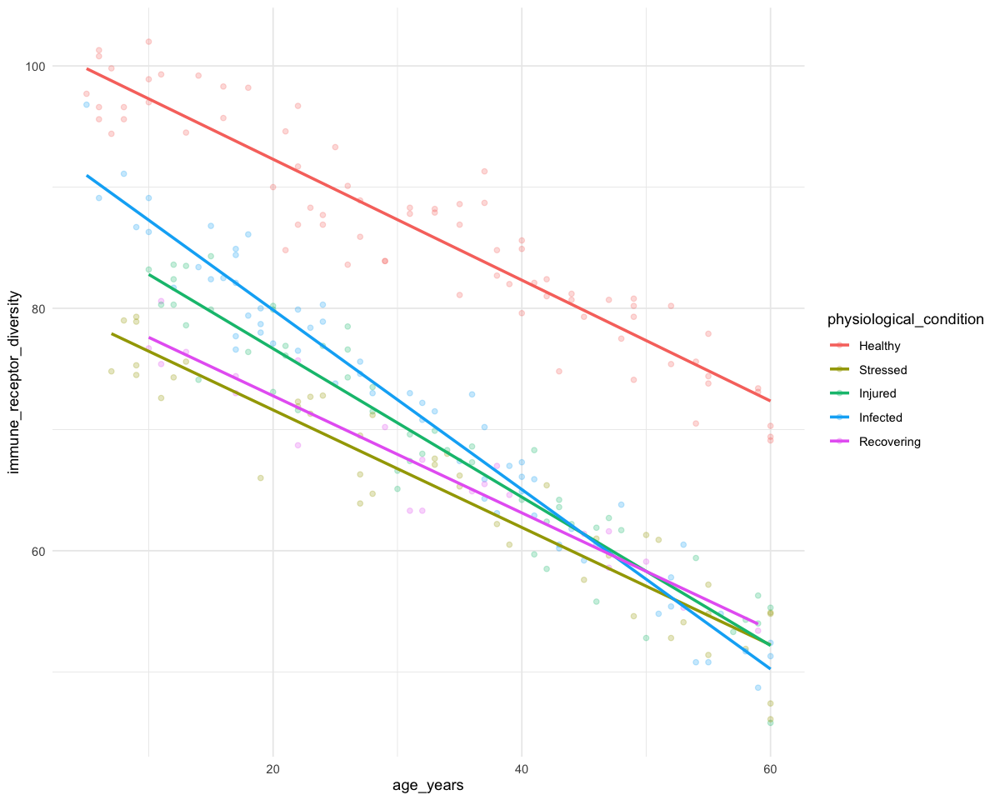

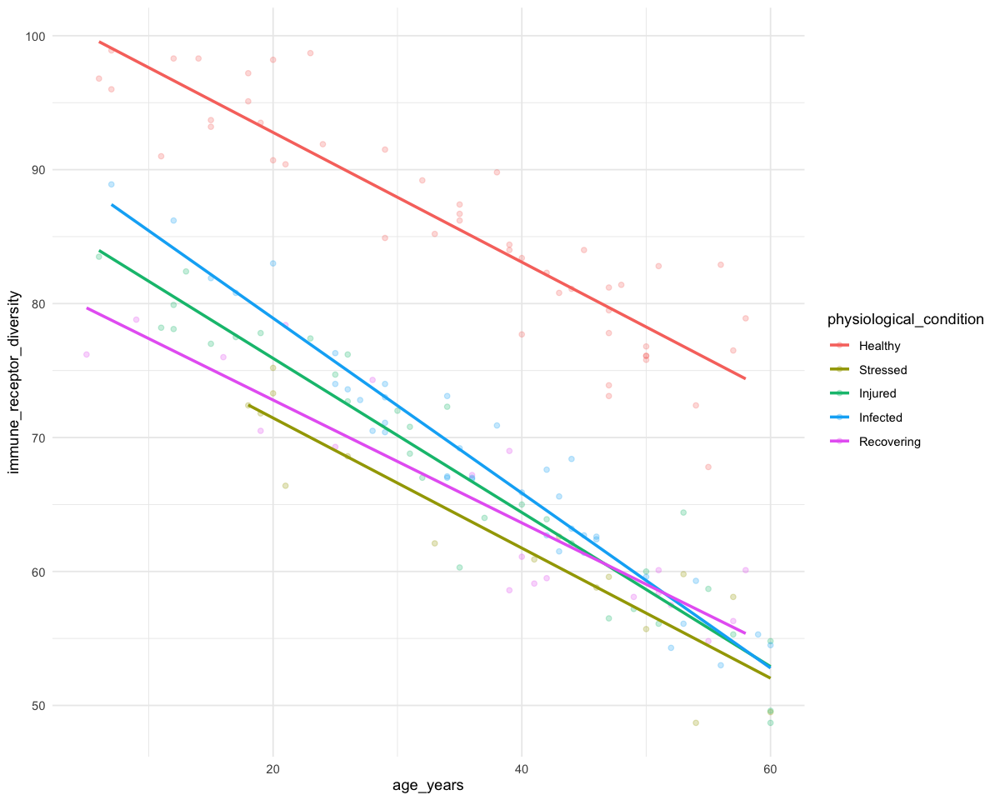

In [114]:
options(repr.plot.width=10, repr.plot.height=8)
ggplot(cell_data(sharks, "NK_cells"), aes(x=age_years, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(cell_data(sharks, "Dendritic_cells"), aes(x=age_years, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

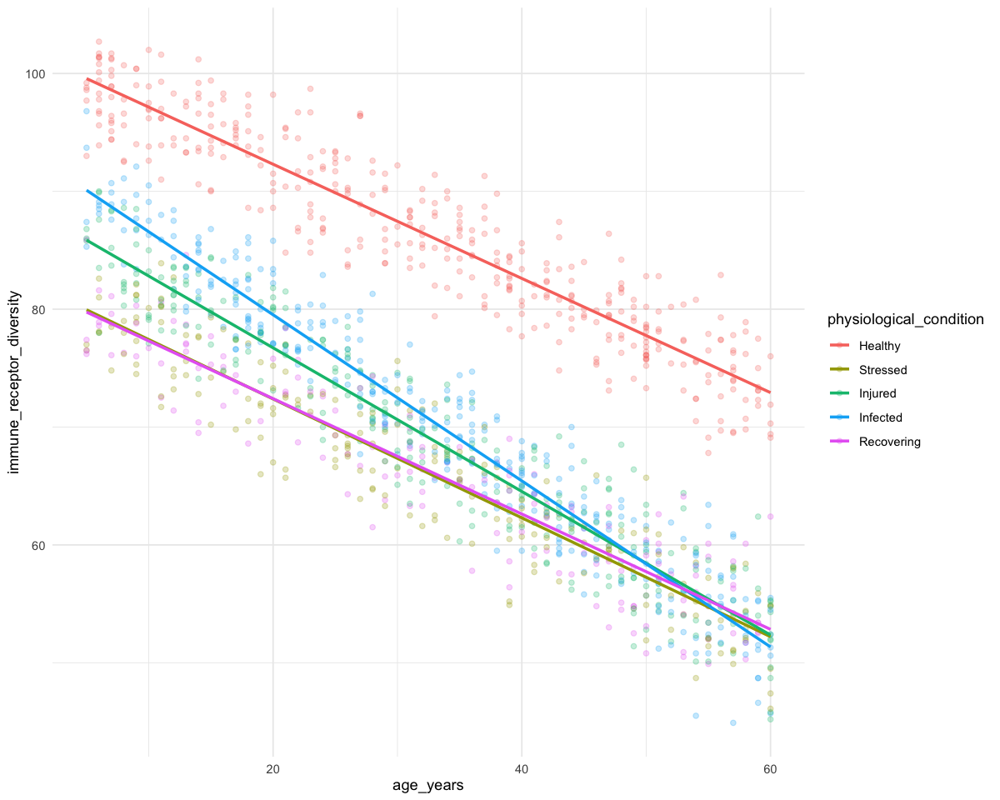

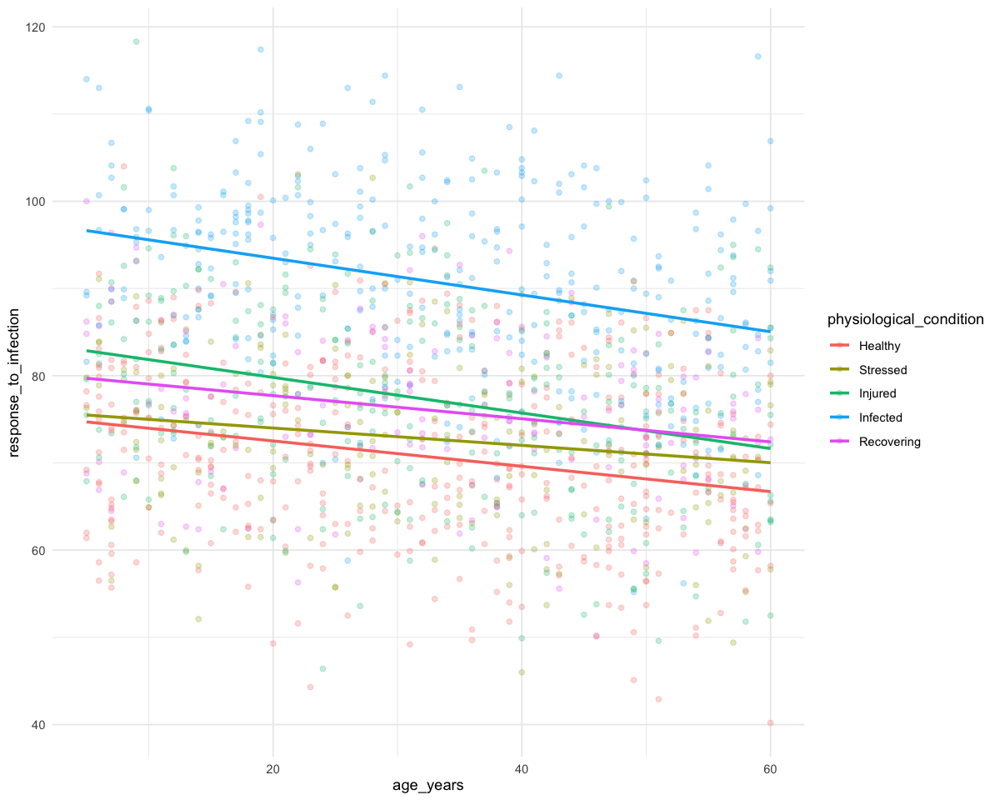

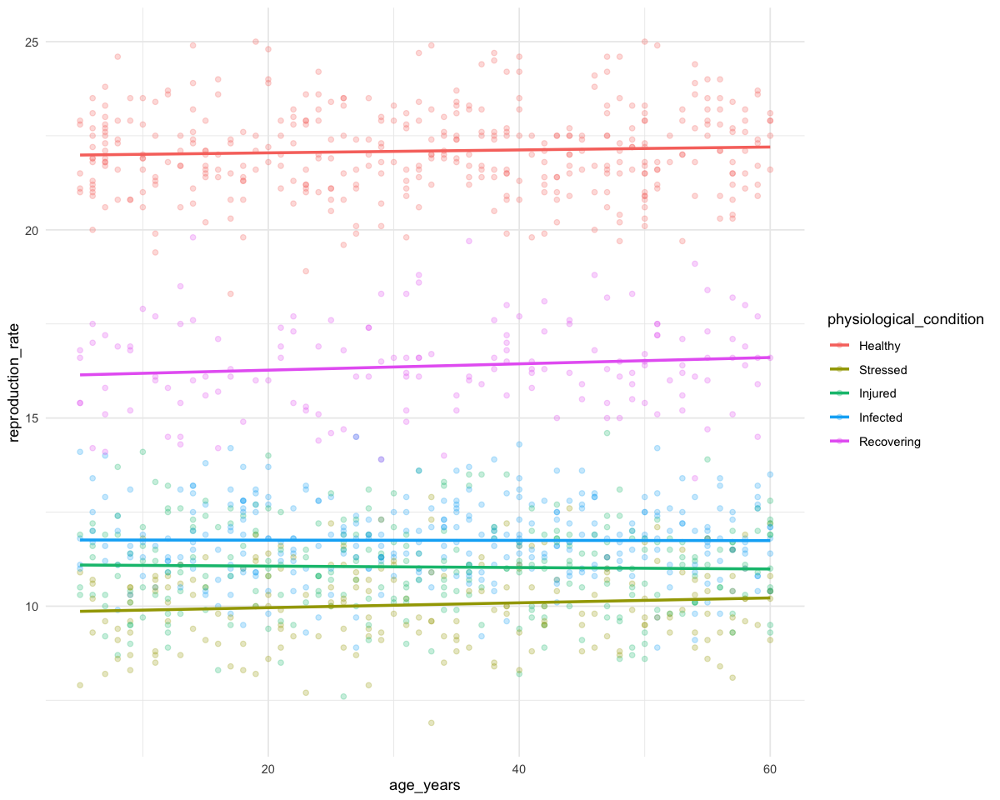

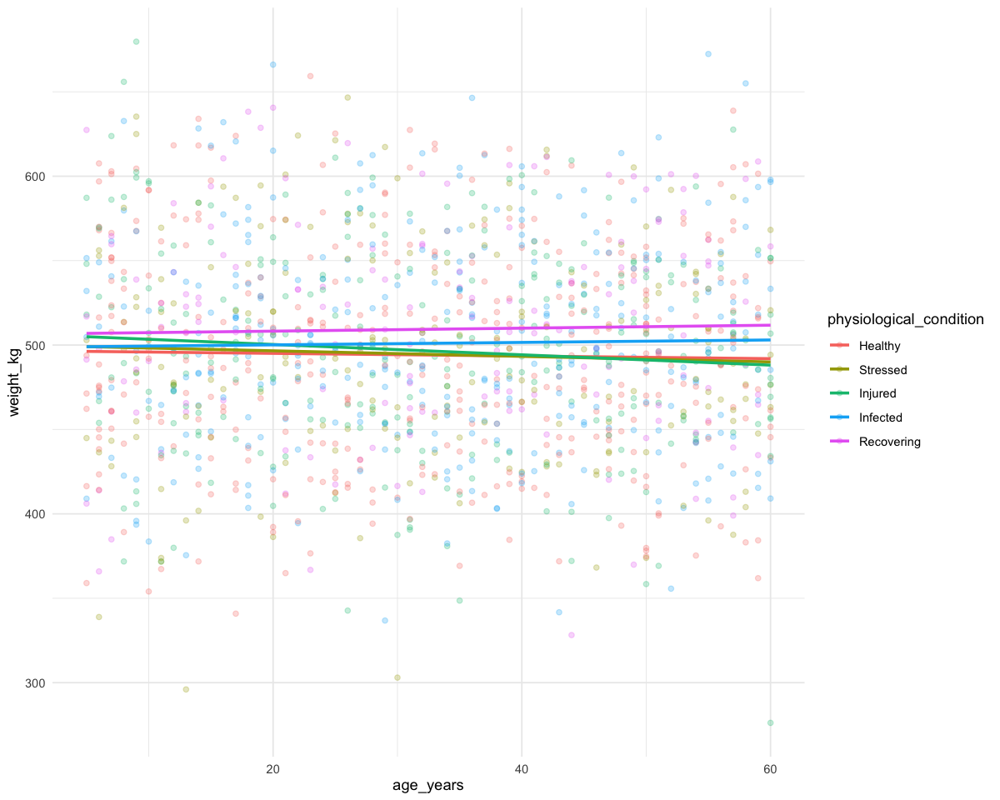

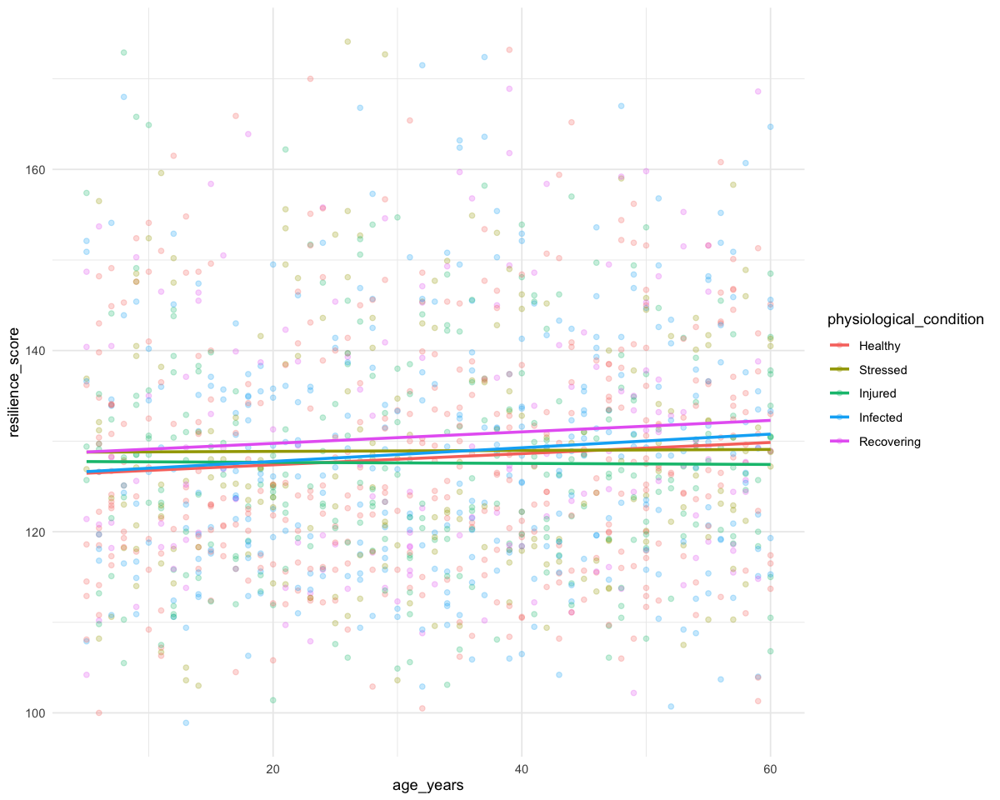

In [123]:
ggplot(sharks, aes(x=age_years, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks, aes(x=age_years, y=response_to_infection, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks, aes(x=age_years, y=reproduction_rate, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks, aes(x=age_years, y=weight_kg, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks, aes(x=age_years, y=resilience_score, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="lm", formula="y~x", se=FALSE) +
    theme_minimal()

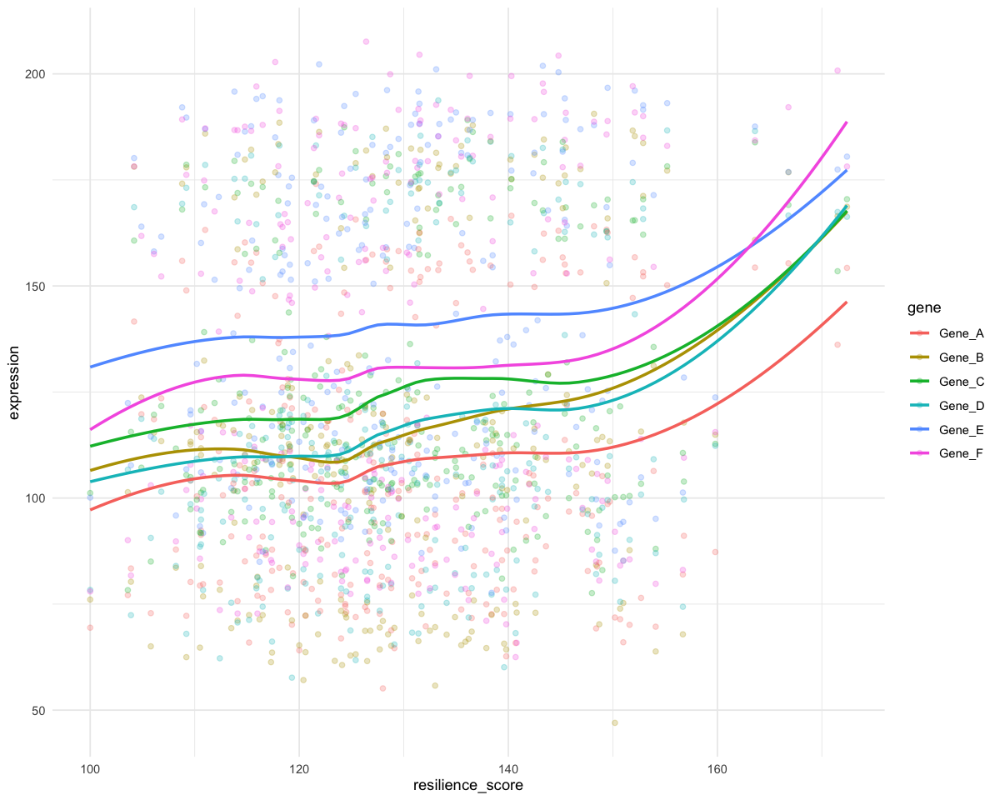

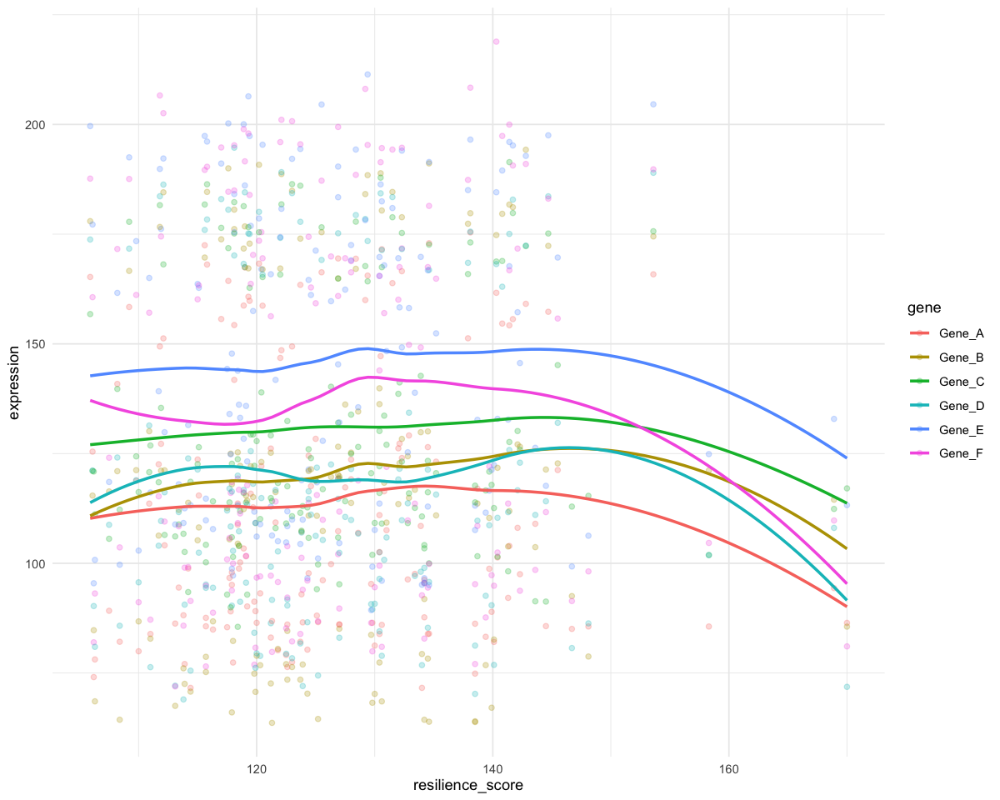

In [110]:
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=resilience_score, y=expression, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"Dendritic_cells"), aes(x=resilience_score, y=expression, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

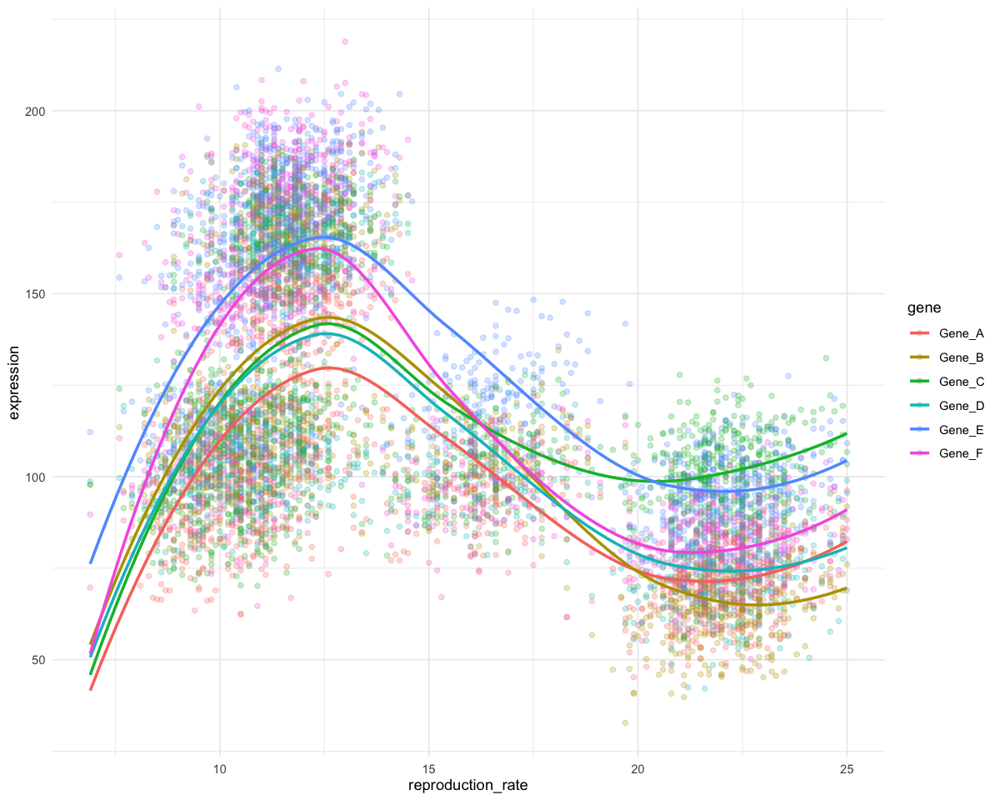

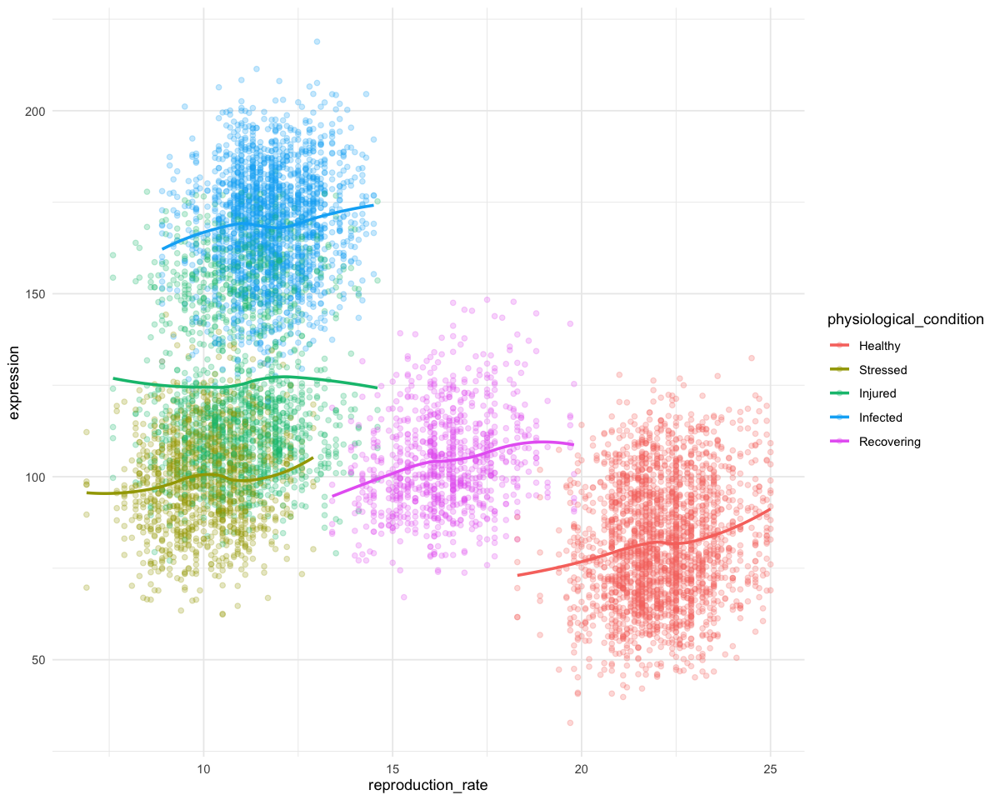

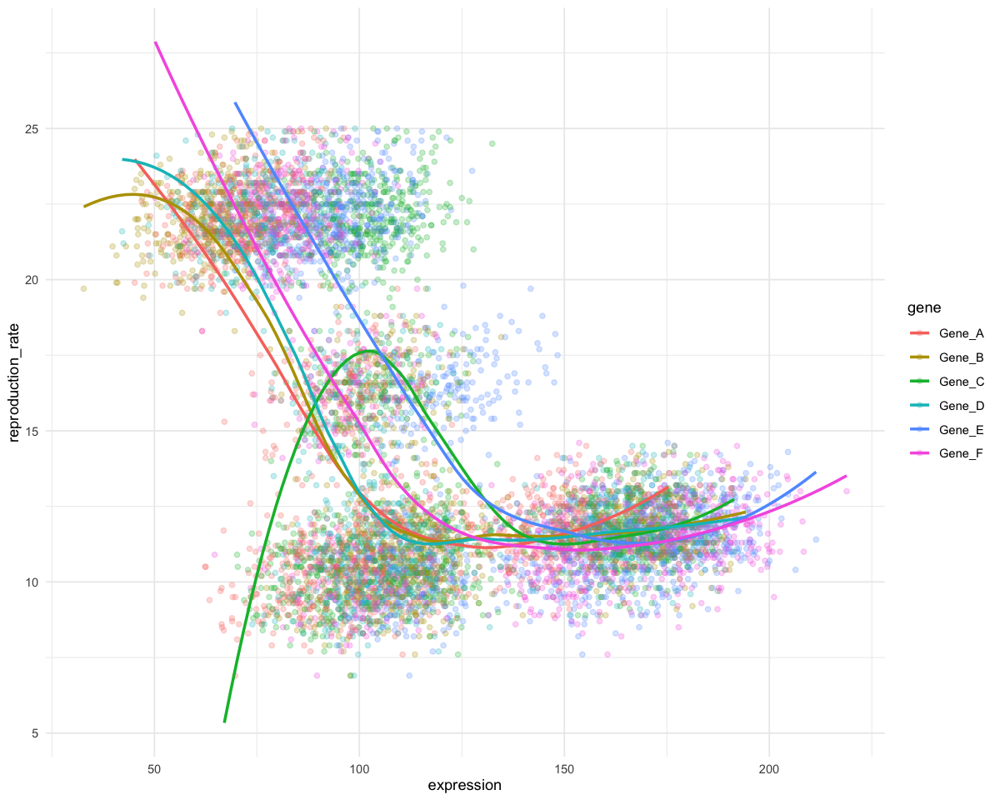

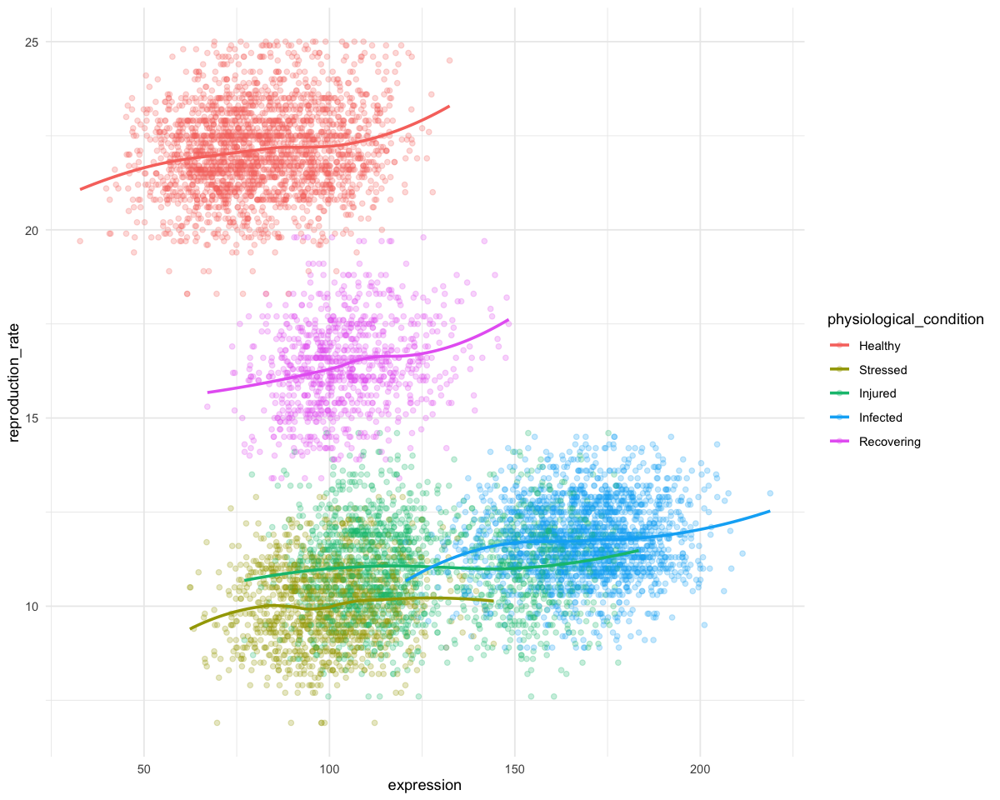

In [132]:
ggplot(sharks_genes, aes(x=reproduction_rate, y=expression, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=reproduction_rate, y=expression, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=reproduction_rate, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=reproduction_rate, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

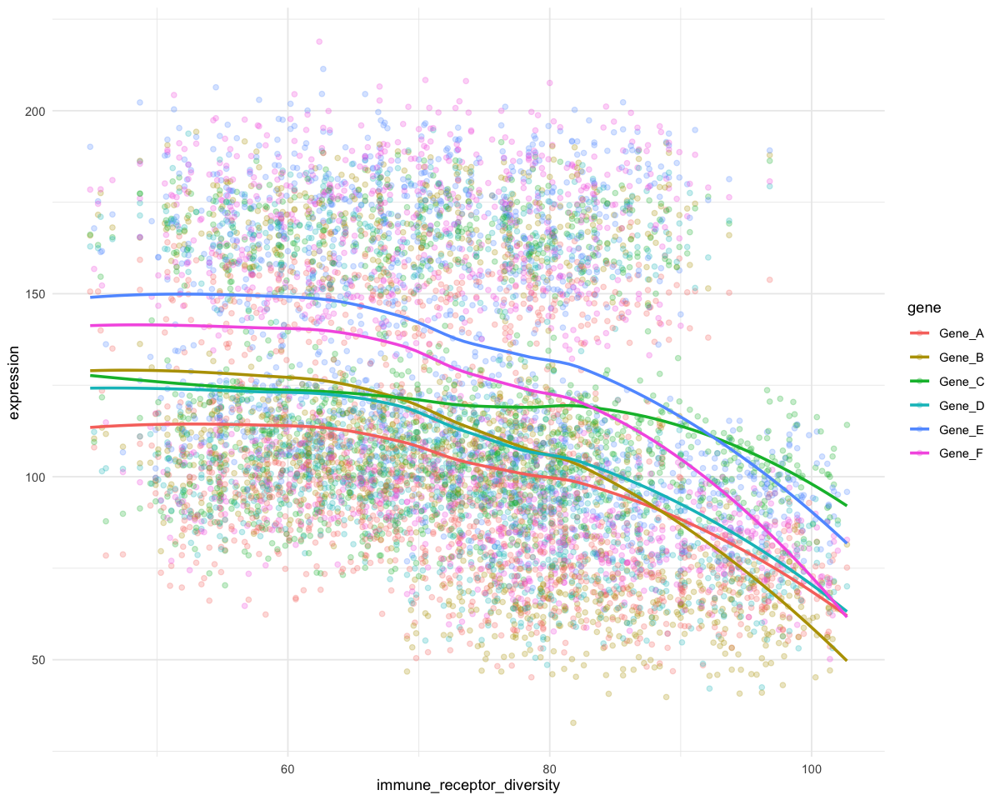

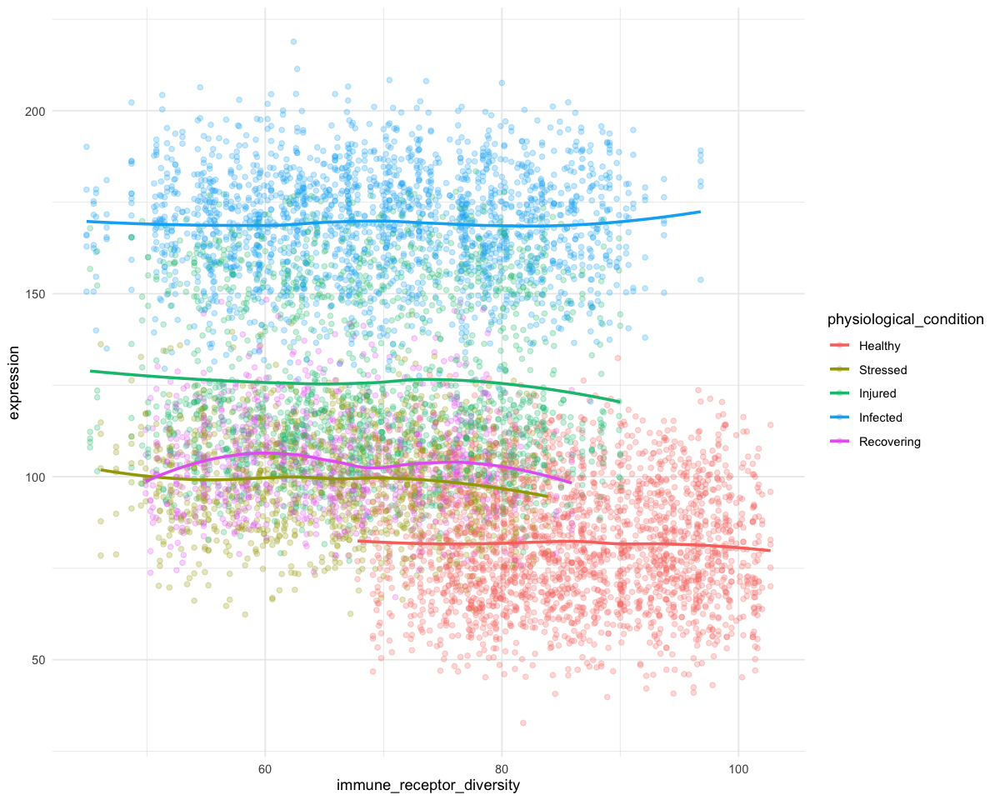

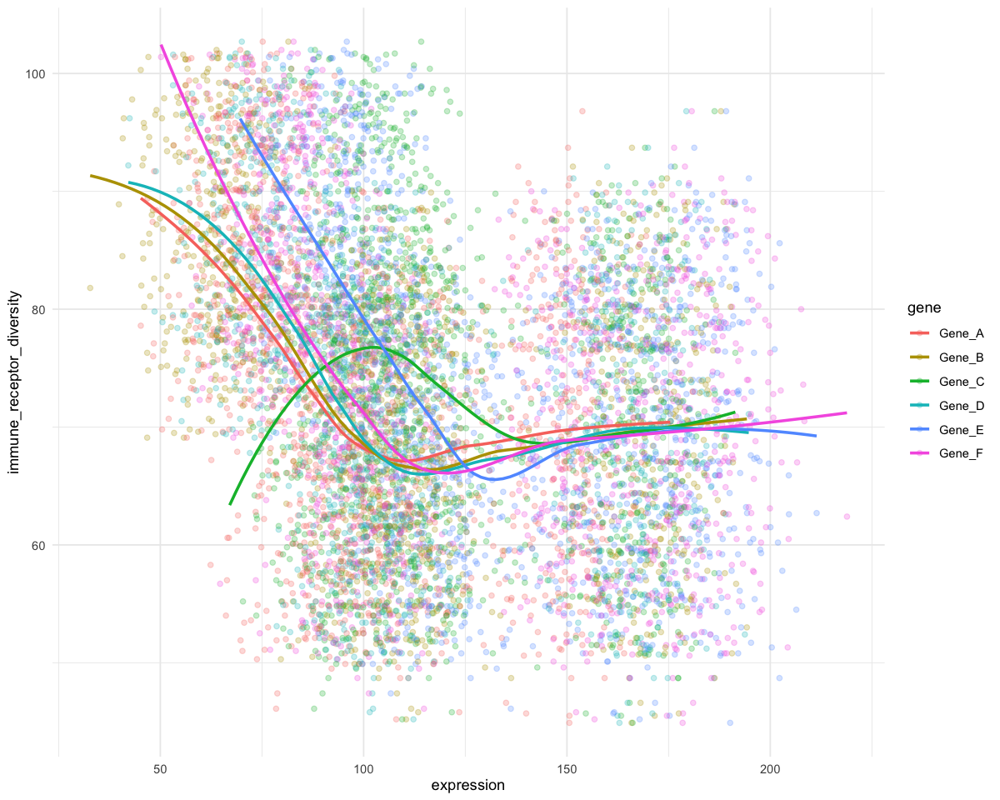

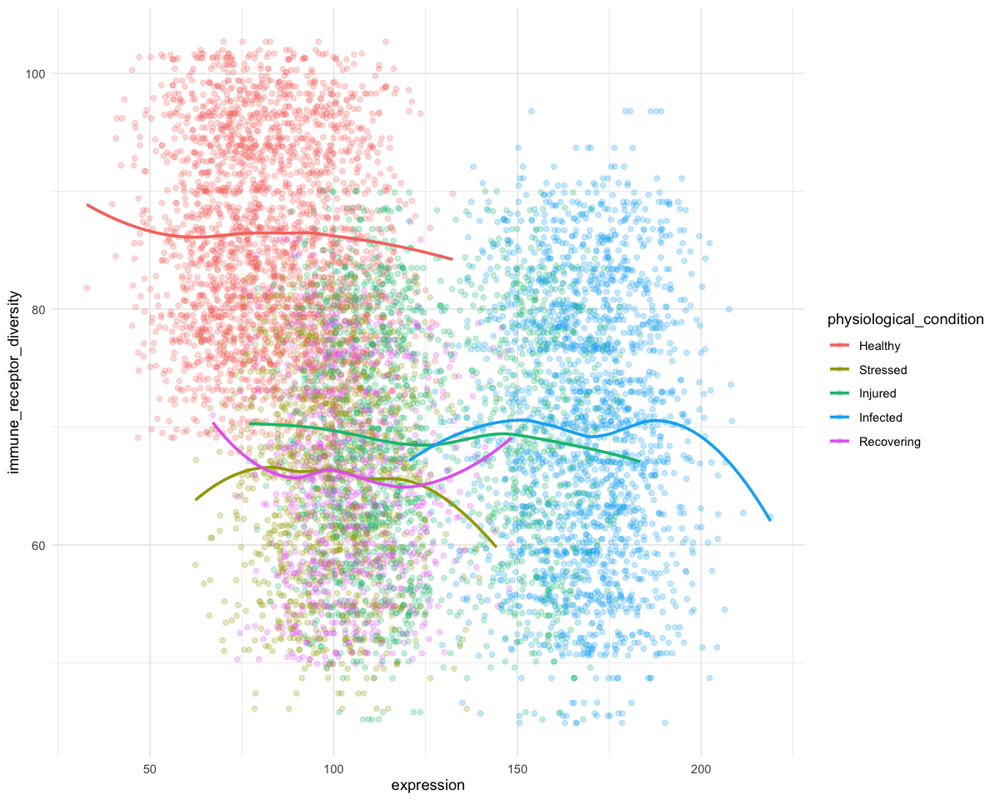

In [134]:
ggplot(sharks_genes, aes(x=immune_receptor_diversity, y=expression, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=immune_receptor_diversity, y=expression, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=immune_receptor_diversity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

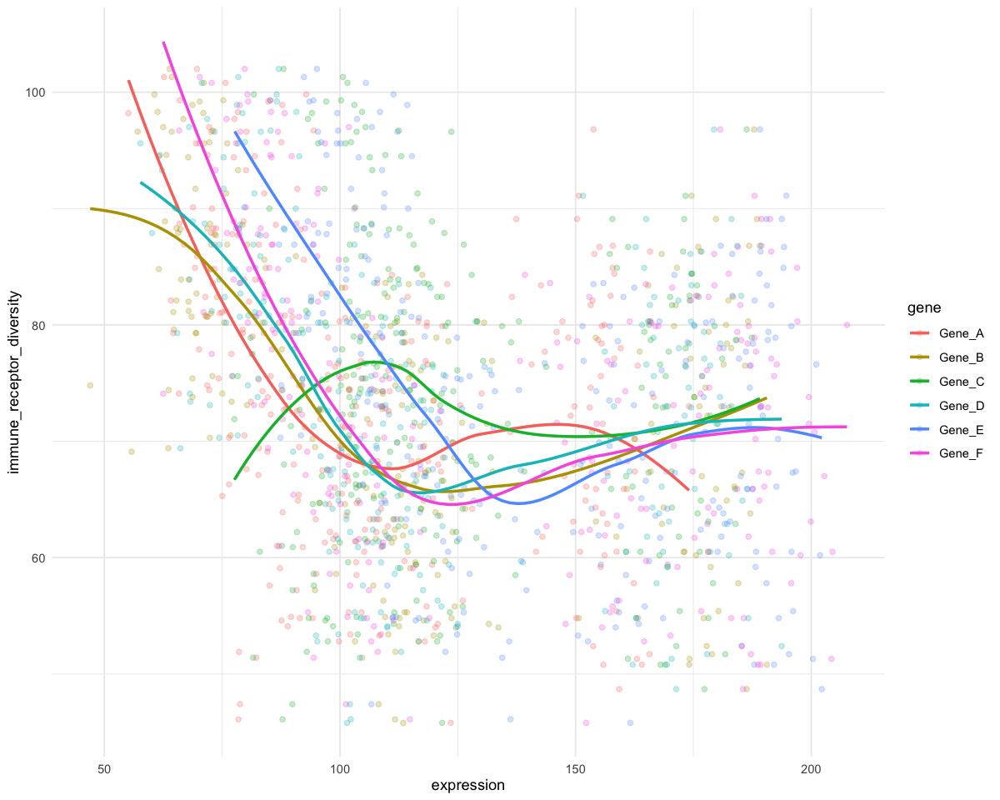

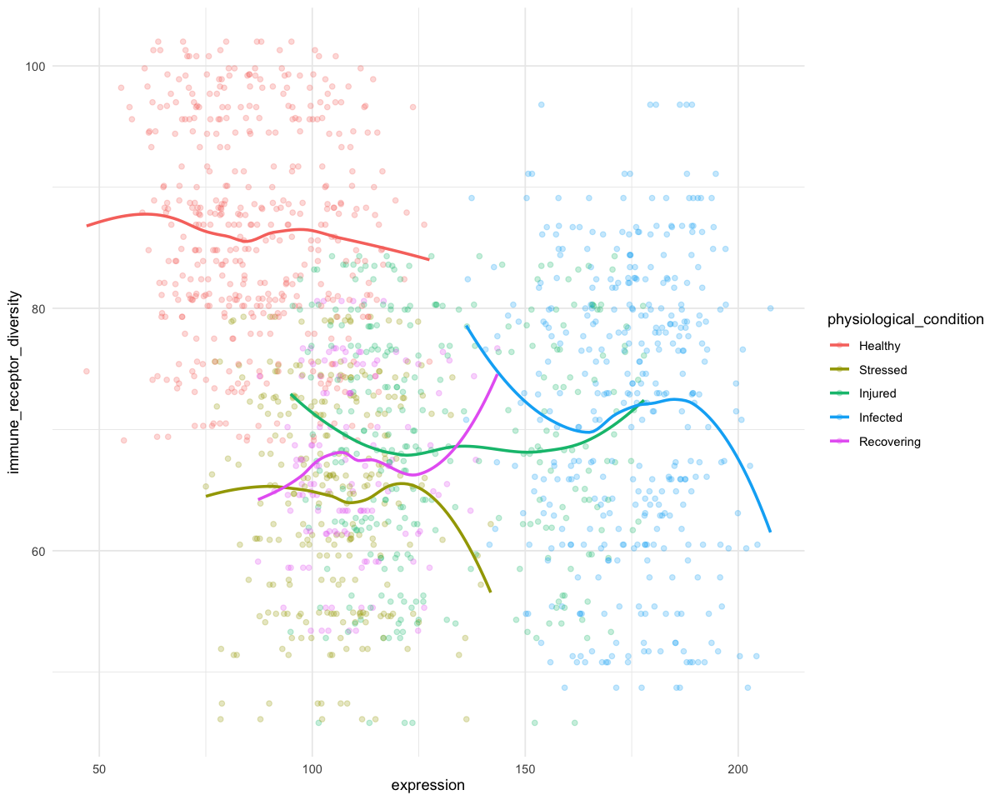

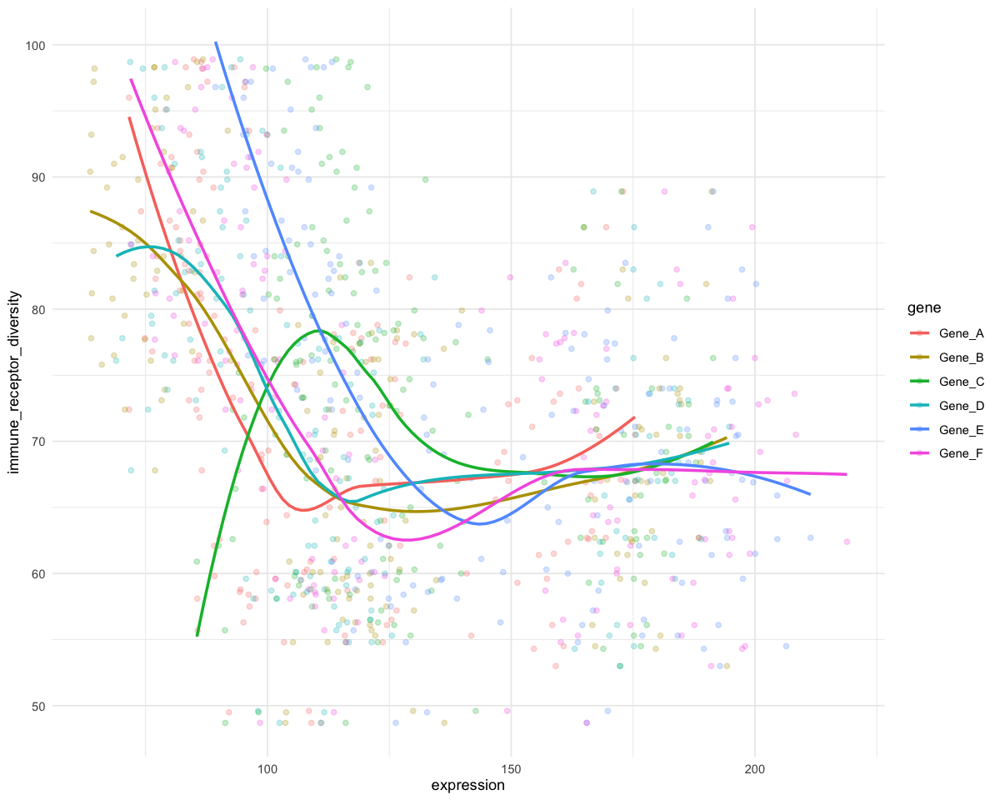

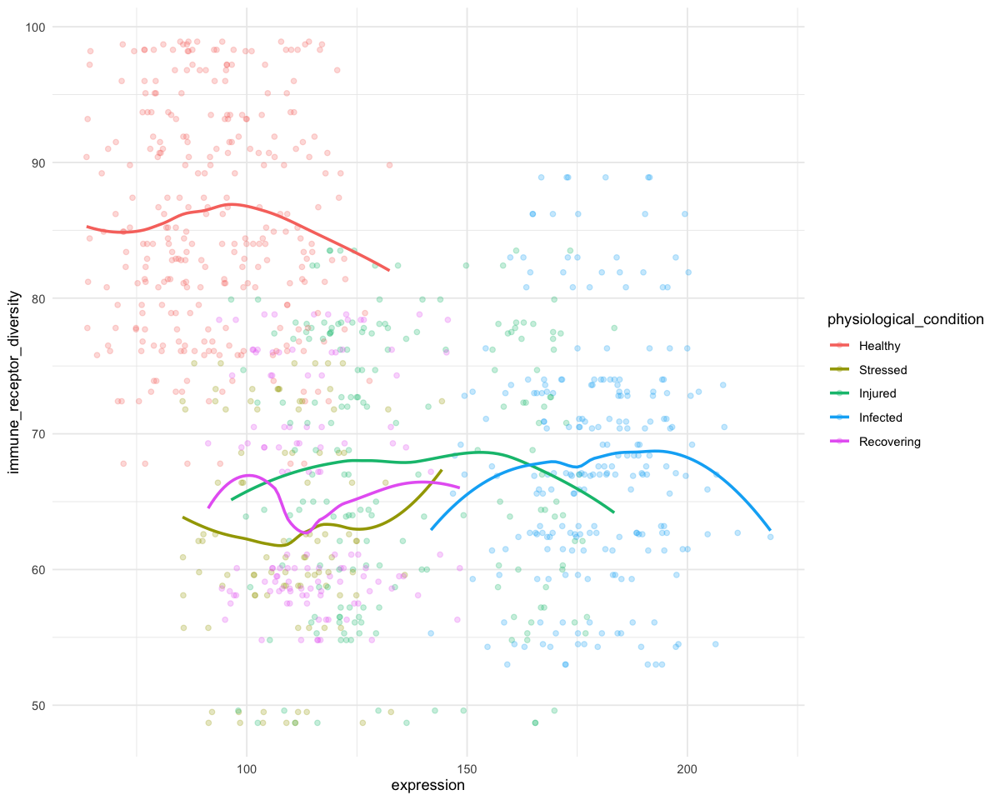

In [136]:
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=immune_receptor_diversity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"Dendritic_cells"), aes(x=expression, y=immune_receptor_diversity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"Dendritic_cells"), aes(x=expression, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

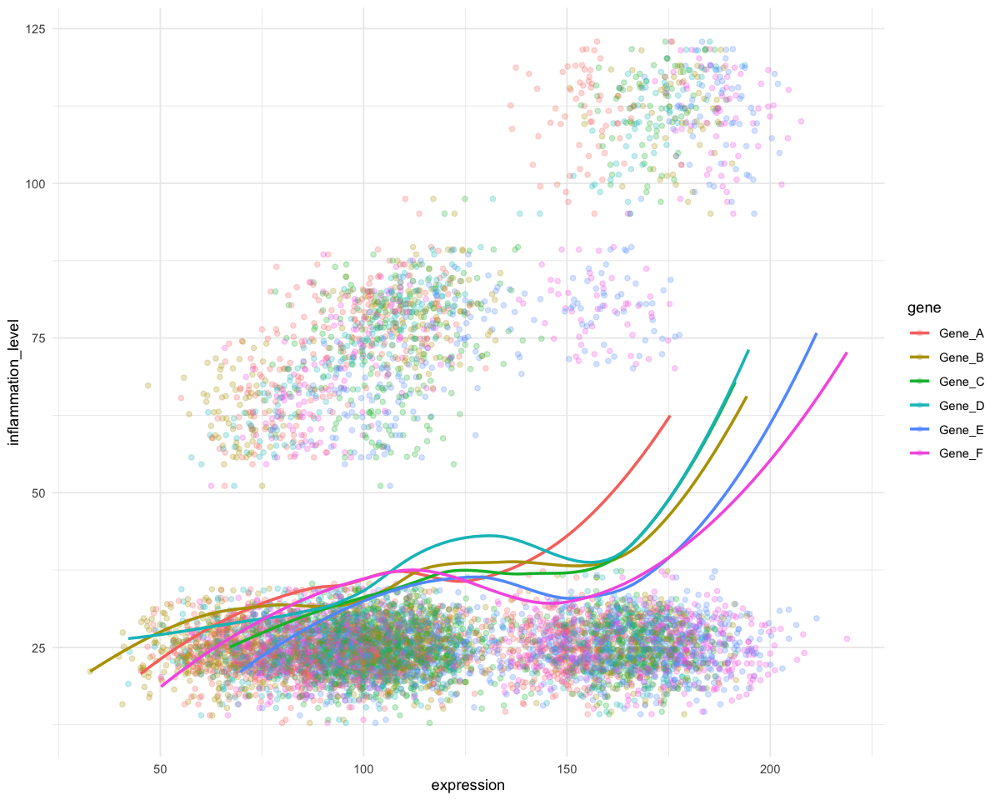

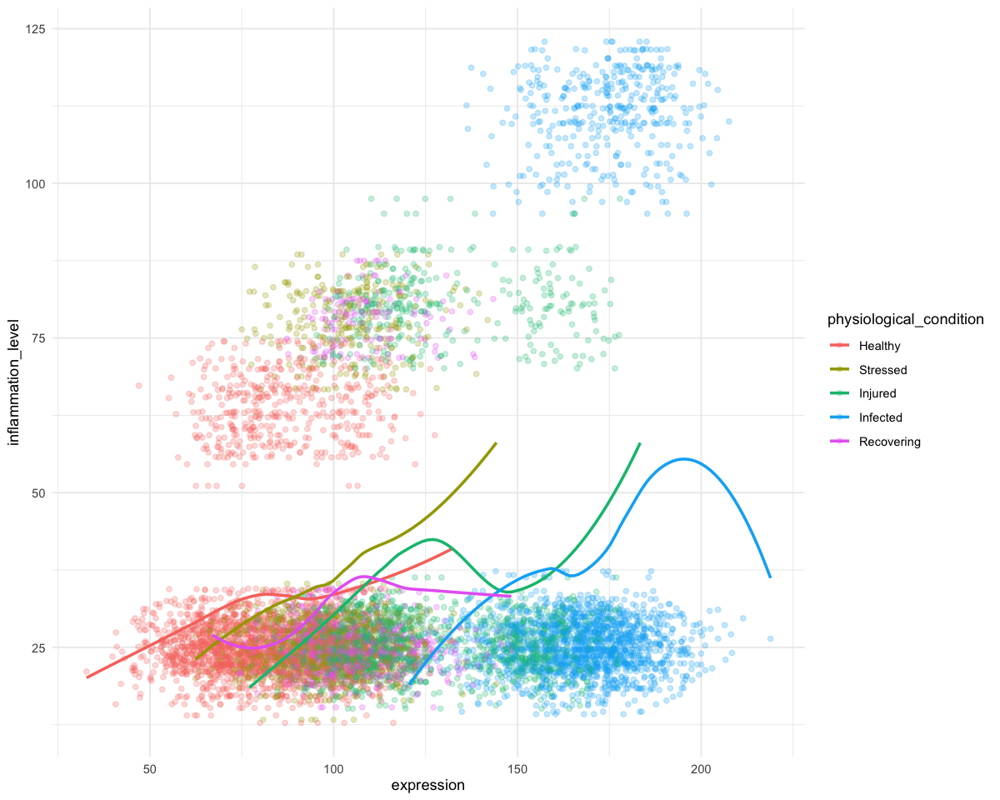

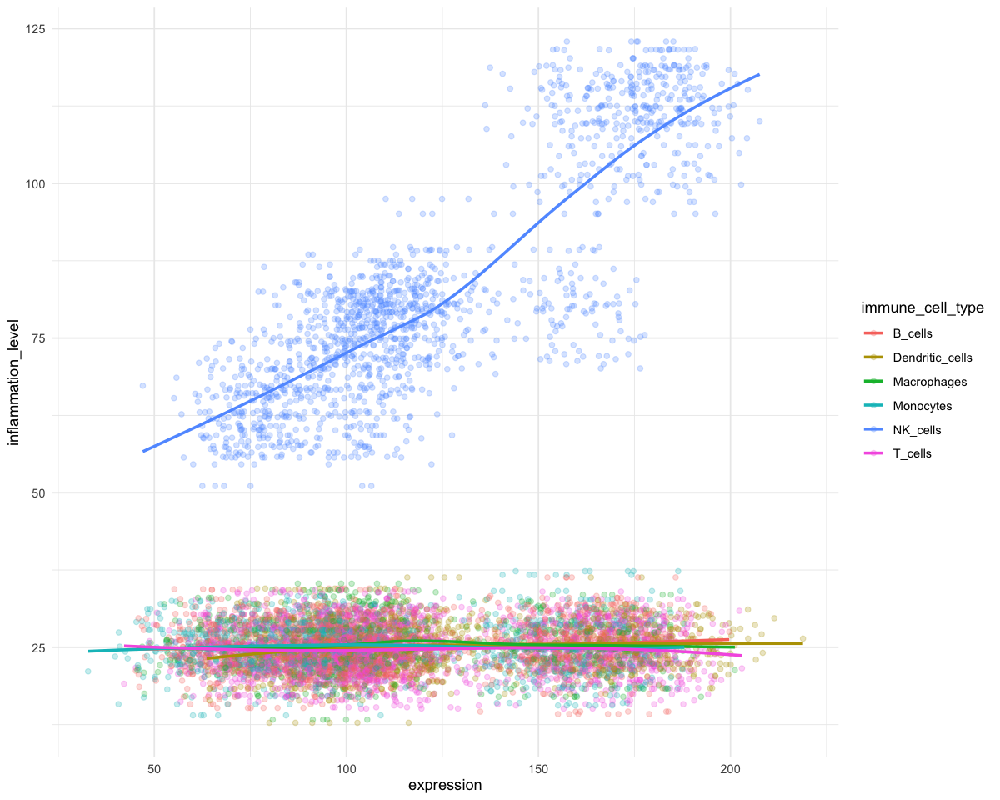

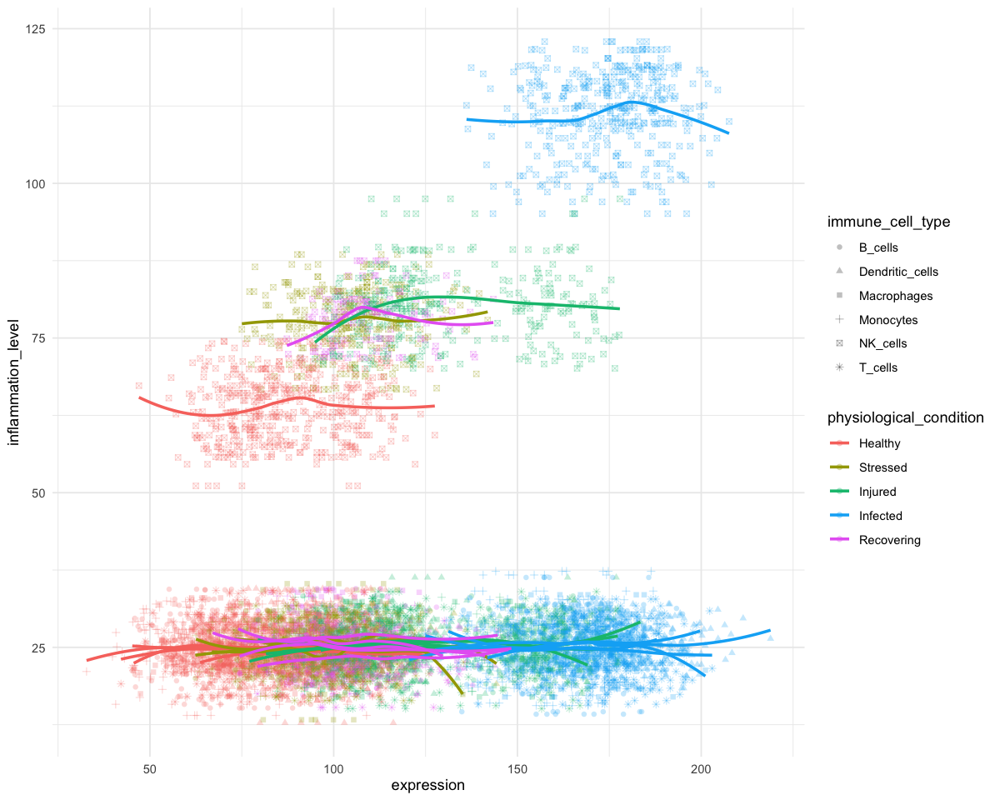

In [145]:
ggplot(sharks_genes, aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=inflammation_level, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=inflammation_level, col=immune_cell_type)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

ggplot(sharks_genes, aes(x=expression, y=inflammation_level, col=physiological_condition, shape=immune_cell_type)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()

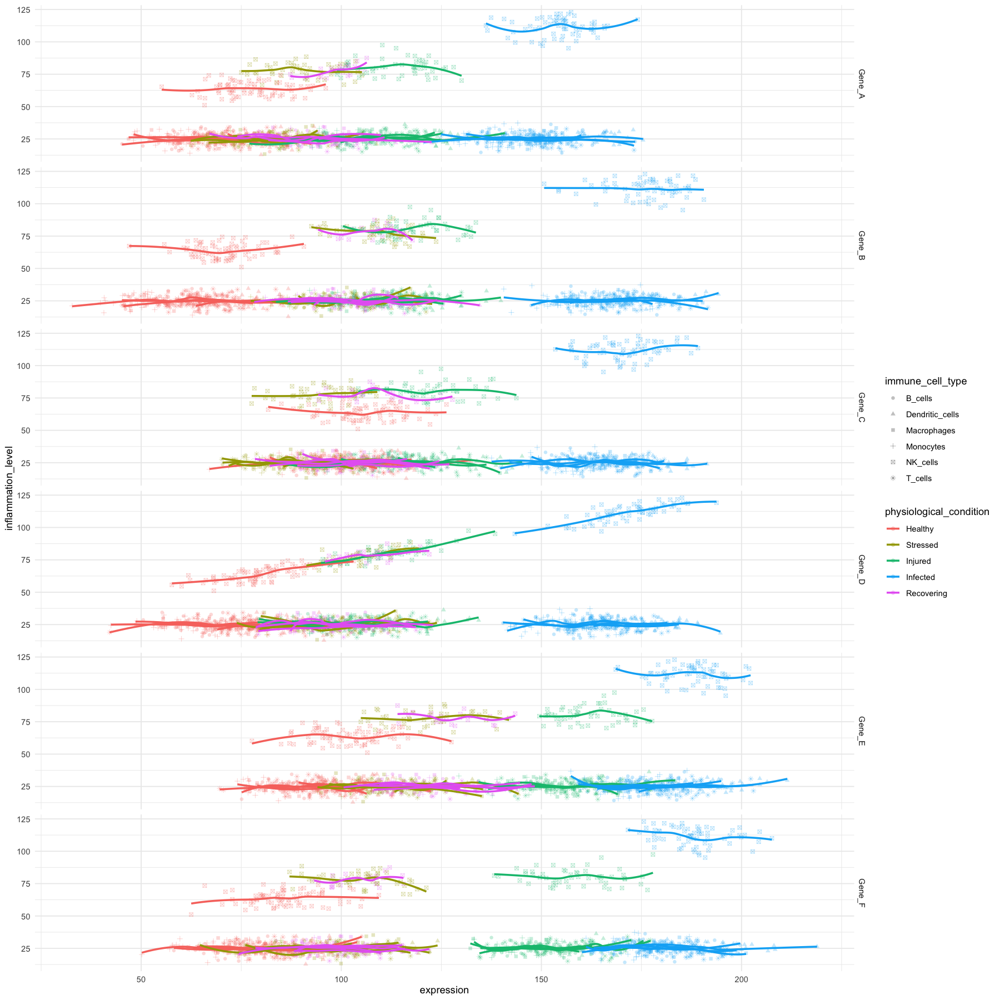

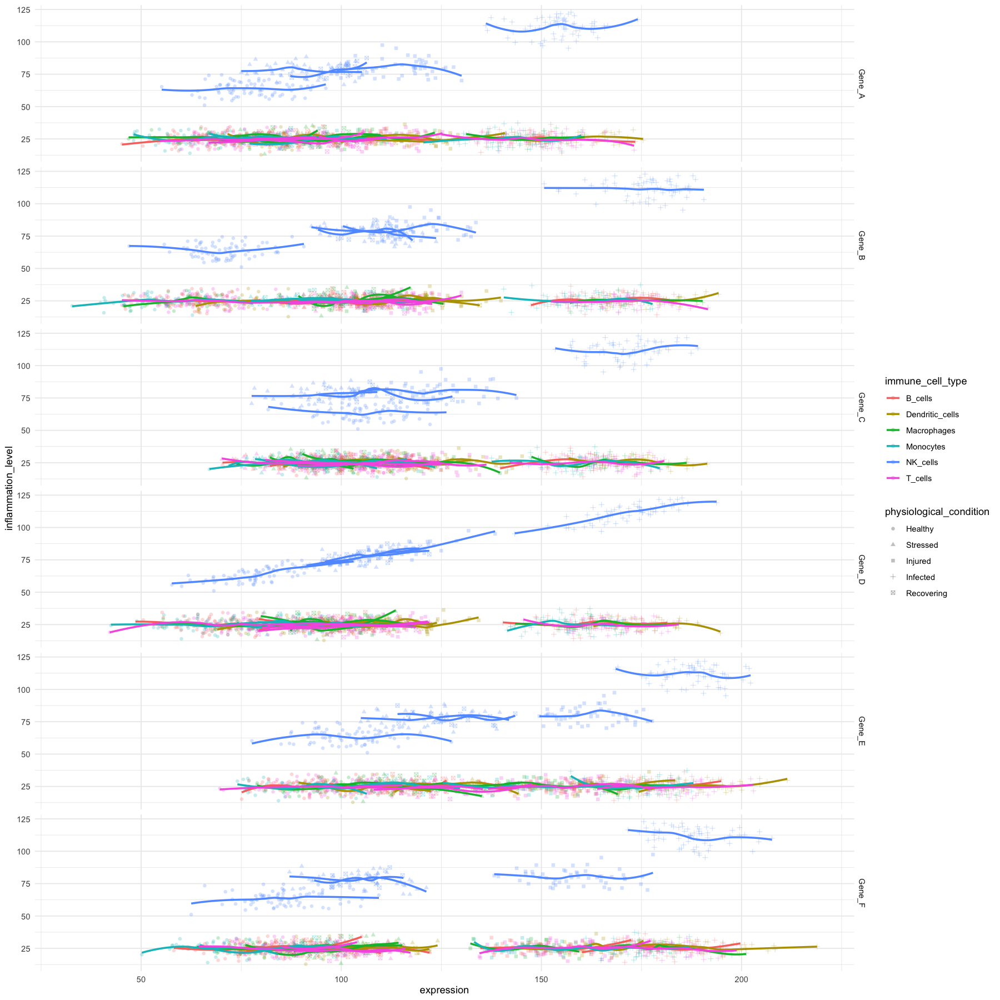

In [161]:
options(repr.plot.width=15, repr.plot.height=15)
ggplot(sharks_genes, aes(x=expression, y=inflammation_level, col=physiological_condition, shape=immune_cell_type)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

options(repr.plot.width=15, repr.plot.height=15)
ggplot(sharks_genes, aes(x=expression, y=inflammation_level, col=immune_cell_type, shape=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

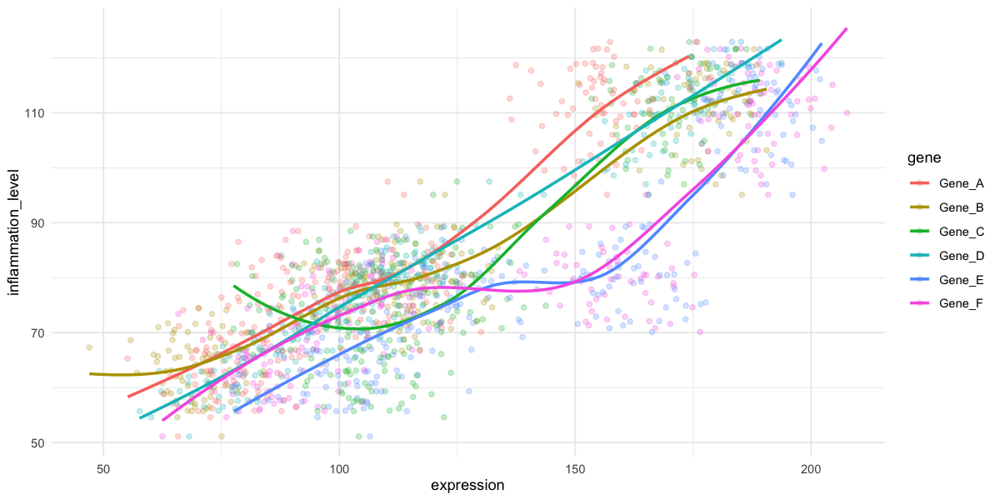

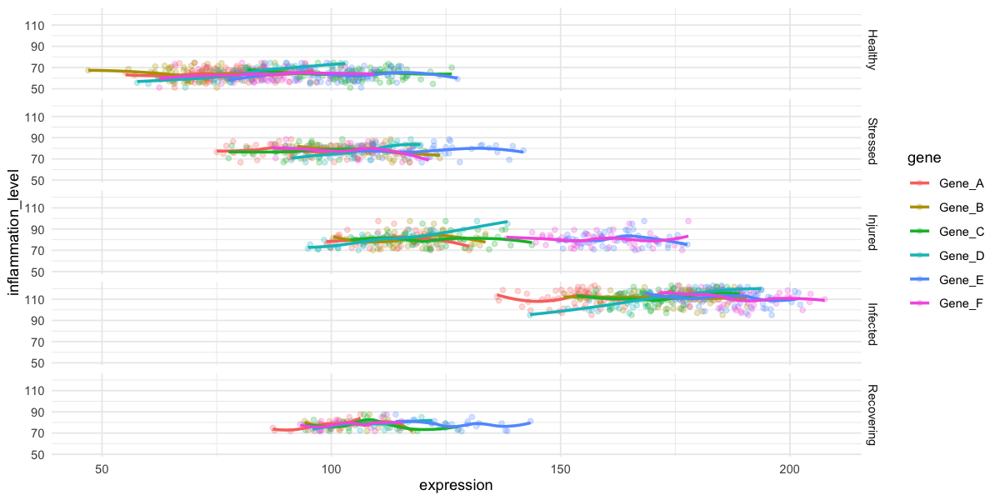

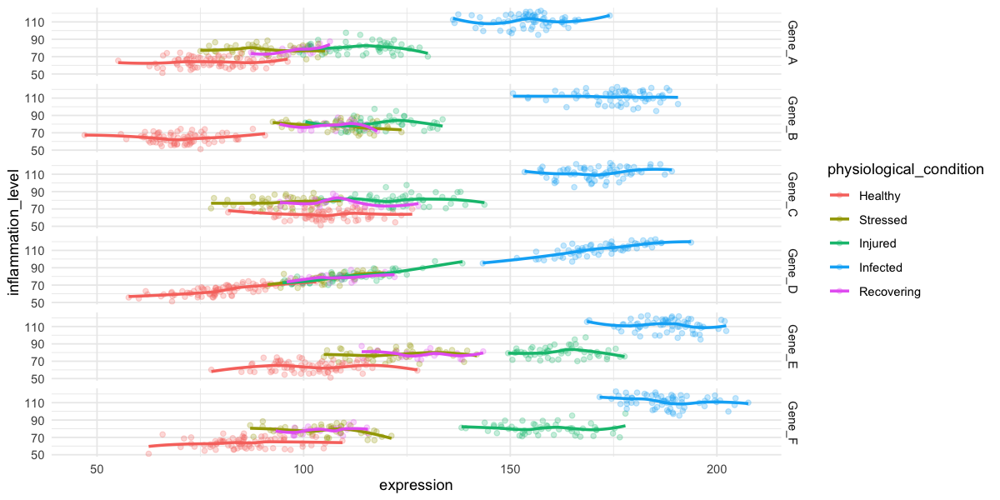

In [175]:
options(repr.plot.width=10, repr.plot.height=5)
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=inflammation_level, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

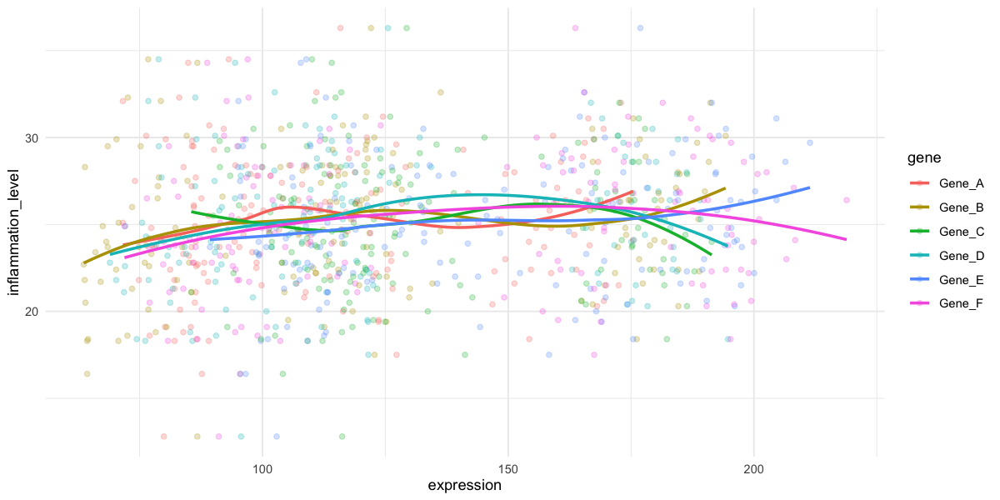

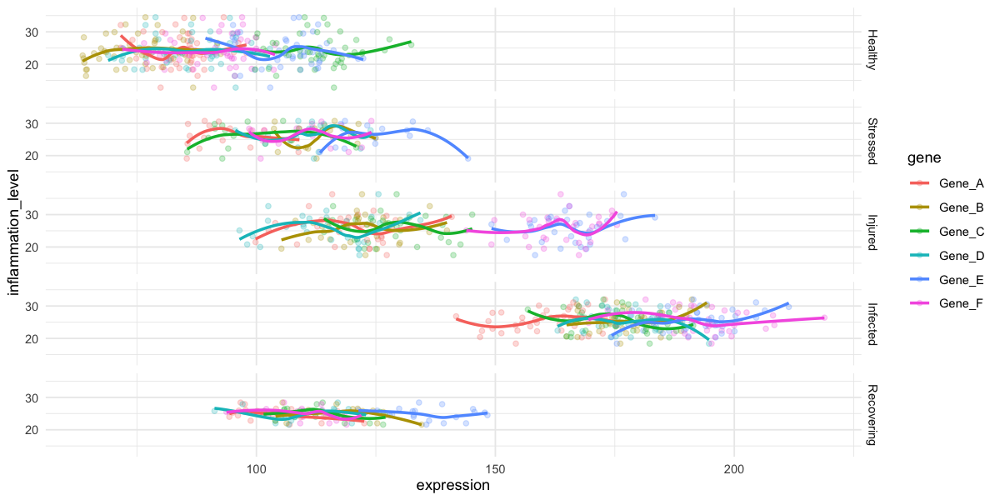

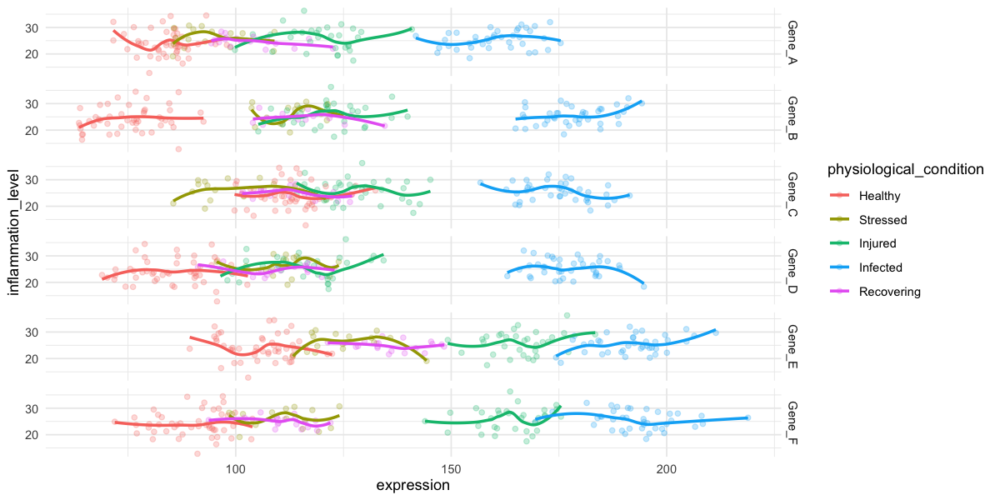

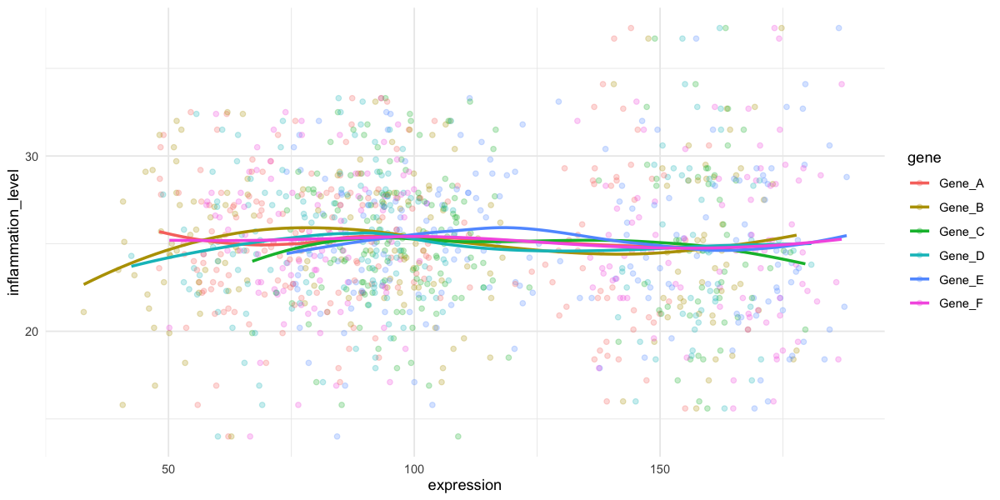

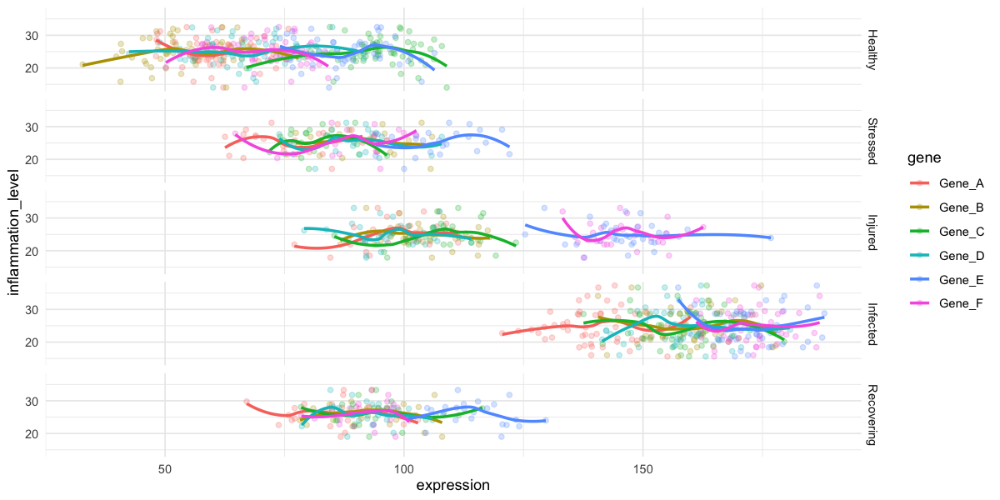

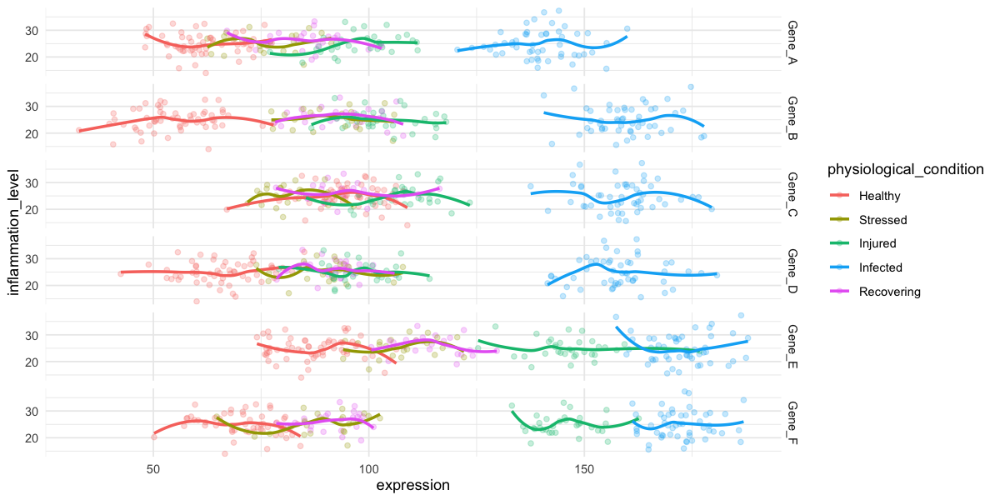

In [178]:
ggplot(cell_data(sharks_genes,"Dendritic_cells"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"Dendritic_cells"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"Dendritic_cells"), aes(x=expression, y=inflammation_level, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"Monocytes"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"Monocytes"), aes(x=expression, y=inflammation_level, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"Monocytes"), aes(x=expression, y=inflammation_level, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

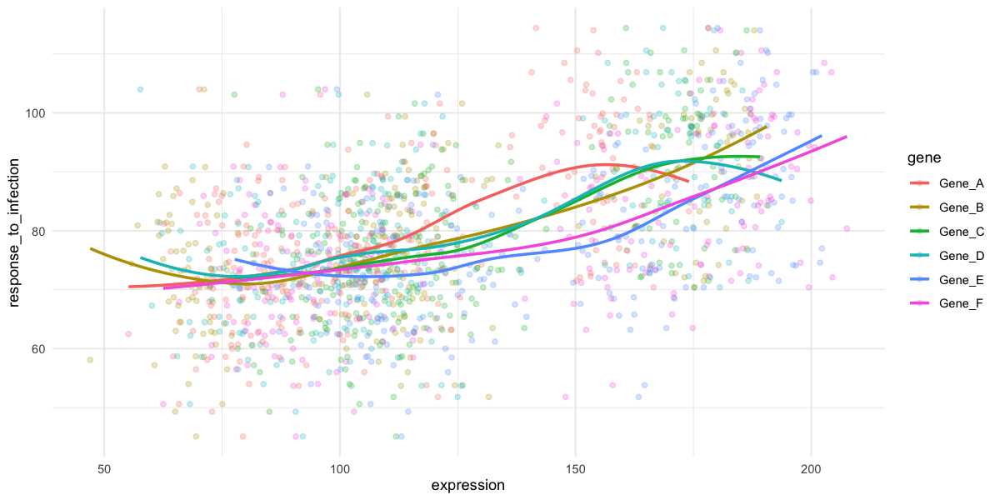

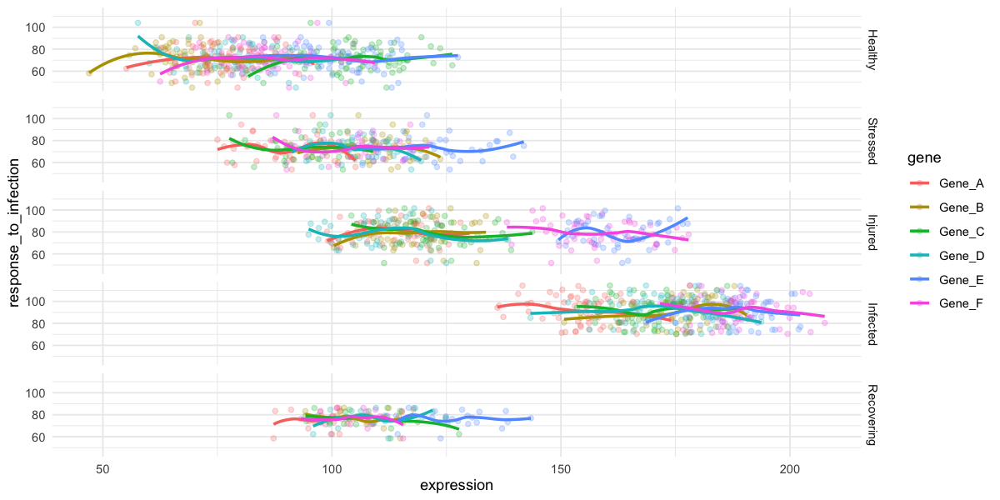

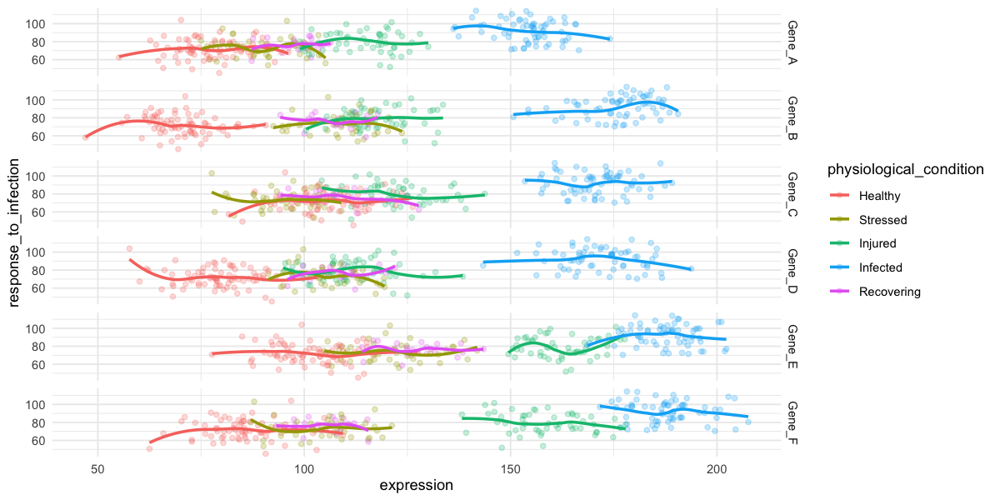

In [179]:
options(repr.plot.width=10, repr.plot.height=5)
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=response_to_infection, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=response_to_infection, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=response_to_infection, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

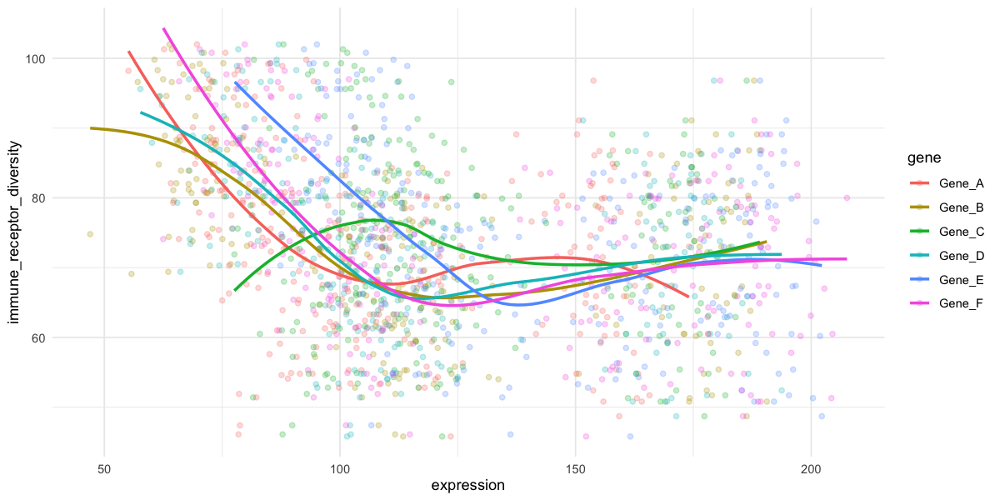

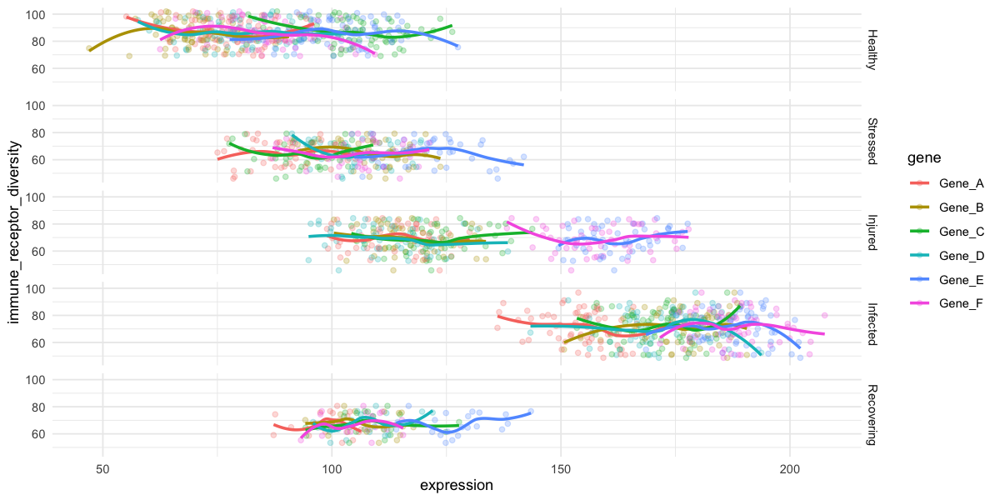

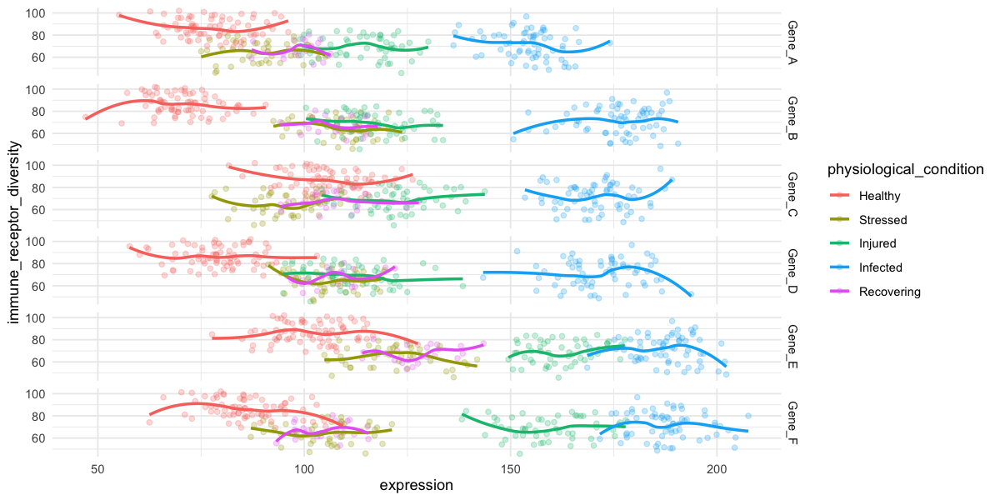

In [180]:
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=immune_receptor_diversity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=immune_receptor_diversity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=immune_receptor_diversity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

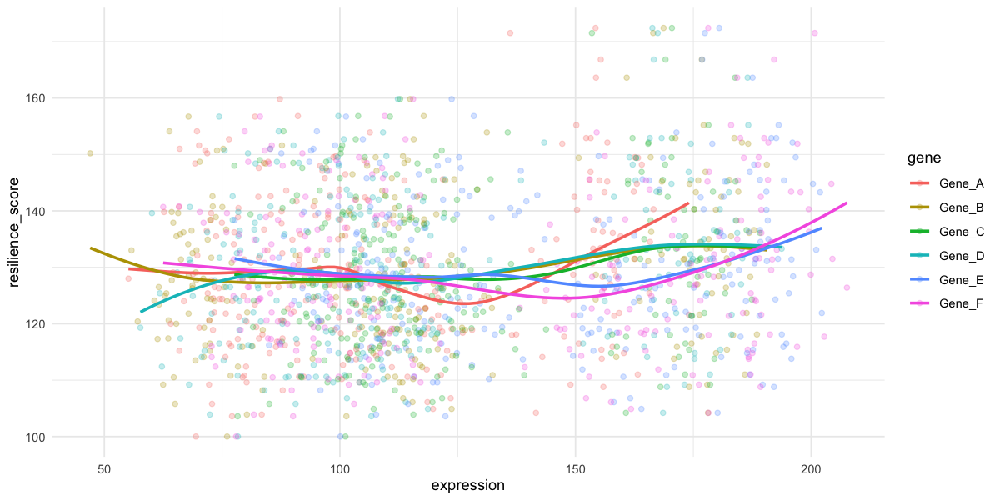

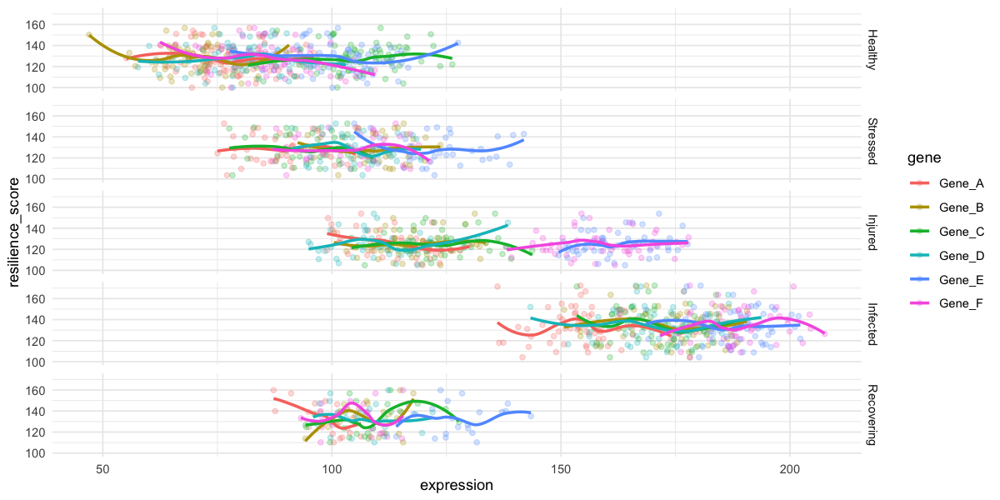

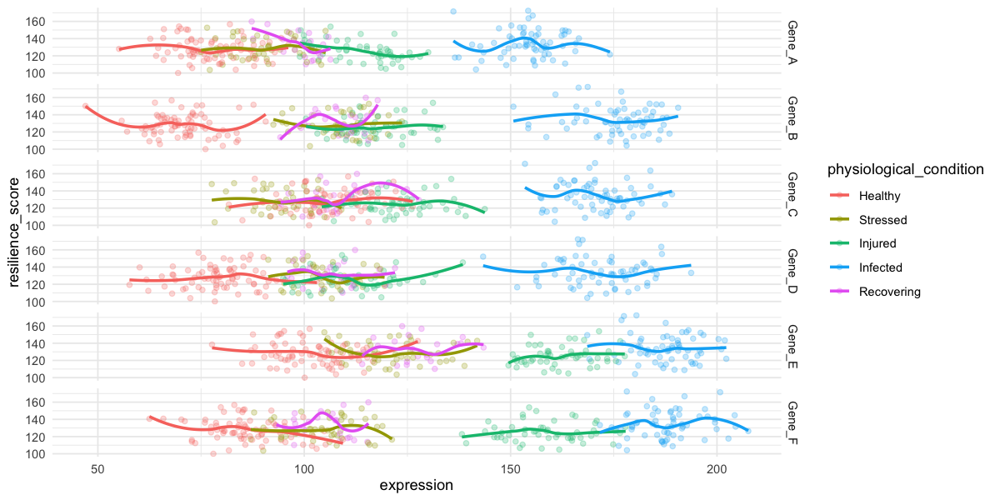

In [181]:
options(repr.plot.width=10, repr.plot.height=5)
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=resilience_score, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=resilience_score, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=resilience_score, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

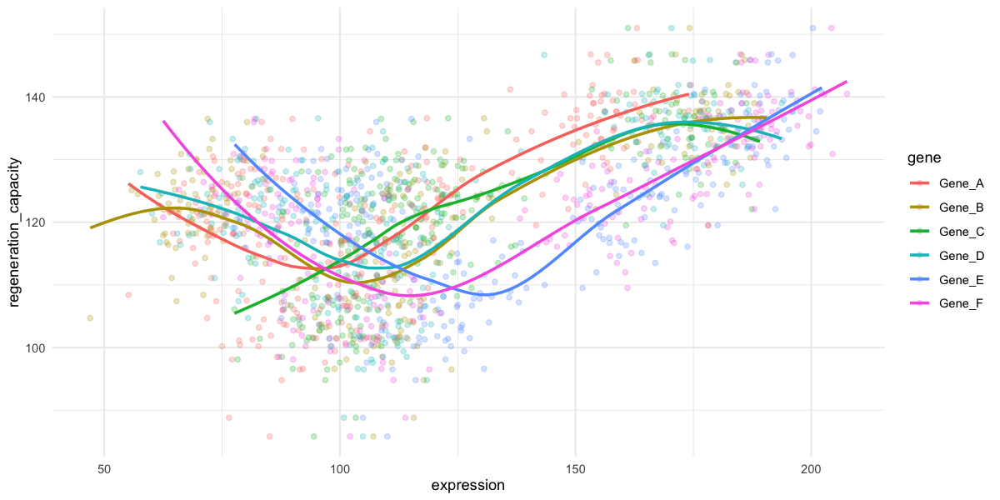

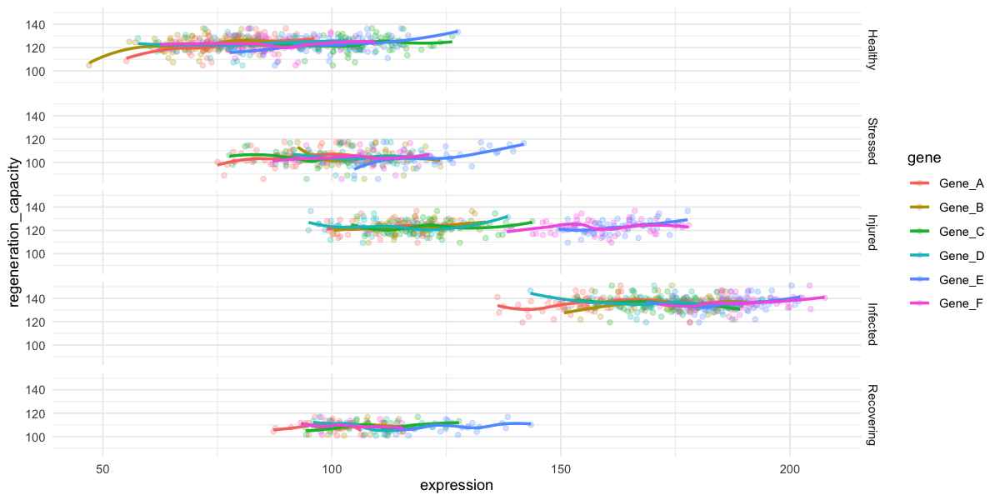

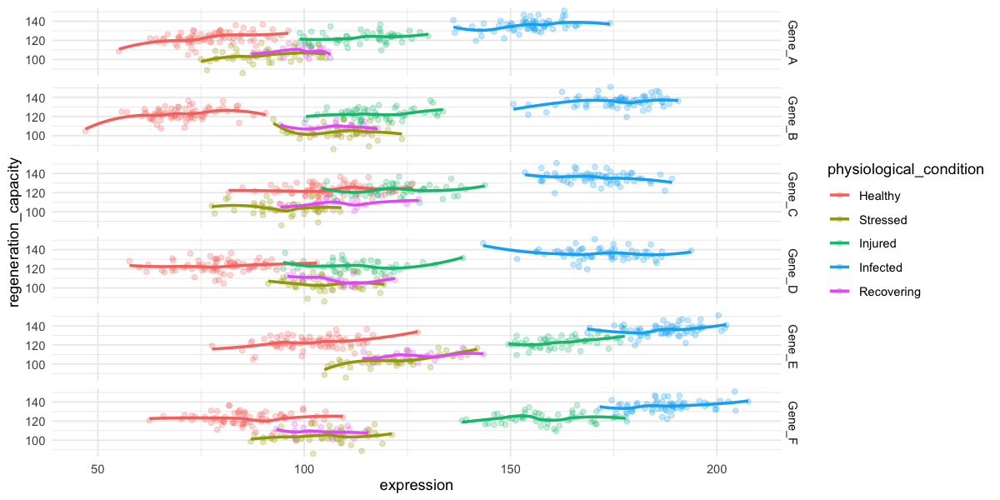

In [182]:
options(repr.plot.width=10, repr.plot.height=5)
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=regeneration_capacity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    theme_minimal()
    
ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=regeneration_capacity, col=gene)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(physiological_condition)) +
    theme_minimal()

ggplot(cell_data(sharks_genes,"NK_cells"), aes(x=expression, y=regeneration_capacity, col=physiological_condition)) +
    geom_point(alpha=0.25, fill=NA) +
    geom_smooth(method="loess", formula="y~x", se=FALSE) +
    facet_grid(rows=vars(gene)) +
    theme_minimal()

In [216]:
sharks_super_long <- sharks %>%
  select(physiological_condition, immune_cell_type, Gene_A, Gene_B, Gene_C, Gene_D, Gene_E, Gene_F, regeneration_capacity, age_years, immune_receptor_diversity, response_to_infection, weight_kg, inflammation_level, resilience_score, reproduction_rate) %>% 
  pivot_longer(cols = -c("physiological_condition","immune_cell_type","Gene_A","Gene_B","Gene_C","Gene_D","Gene_E","Gene_F"), names_to = "variable", values_to = "value") %>%
    select(physiological_condition, immune_cell_type, Gene_A, Gene_B, Gene_C, Gene_D, Gene_E, Gene_F,variable,value) %>% 
    pivot_longer(cols = -c("physiological_condition", "immune_cell_type","variable","value"), names_to = "gene", values_to = "expression")
head(sharks_super_long)
names(sharks_super_long)

physiological_condition,immune_cell_type,variable,value,gene,expression
<fct>,<chr>,<chr>,<dbl>,<chr>,<dbl>
Infected,Monocytes,regeneration_capacity,126.9,Gene_A,144.7960
Infected,Monocytes,regeneration_capacity,126.9,Gene_B,171.1046
Infected,Monocytes,regeneration_capacity,126.9,Gene_C,162.1400
Infected,Monocytes,regeneration_capacity,126.9,Gene_D,158.4442
Infected,Monocytes,regeneration_capacity,126.9,Gene_E,171.3381
Infected,Monocytes,regeneration_capacity,126.9,Gene_F,168.4784


[1] "physiological_condition" "immune_cell_type"       
[3] "variable"                "value"                  
[5] "gene"                    "expression"

`geom_smooth()` using formula = 'y ~ x'


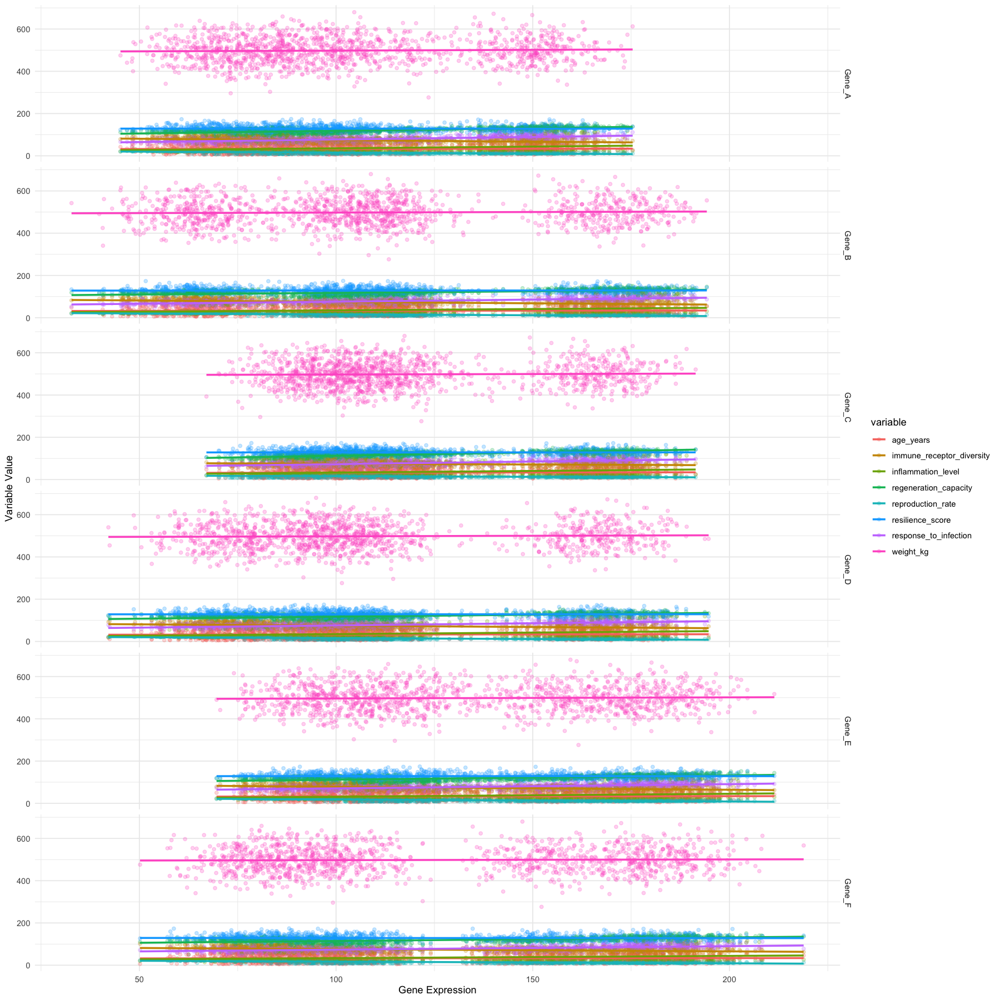

In [221]:
options(repr.plot.width=15, repr.plot.height=15)

ggplot(sharks_super_long, aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression")

In [224]:
sharks_immune <- sharks %>%
  select(physiological_condition, immune_cell_type, Gene_A, Gene_B, Gene_C, Gene_D, Gene_E, Gene_F, immune_receptor_diversity, response_to_infection, inflammation_level) %>% 
  pivot_longer(cols = -c("physiological_condition","immune_cell_type","Gene_A","Gene_B","Gene_C","Gene_D","Gene_E","Gene_F"), names_to = "variable", values_to = "value") %>%
    select(physiological_condition, immune_cell_type, Gene_A, Gene_B, Gene_C, Gene_D, Gene_E, Gene_F,variable,value) %>% 
    pivot_longer(cols = -c("physiological_condition", "immune_cell_type","variable","value"), names_to = "gene", values_to = "expression")
head(sharks_immune)
names(sharks_immune)

physiological_condition,immune_cell_type,variable,value,gene,expression
<fct>,<chr>,<chr>,<dbl>,<chr>,<dbl>
Infected,Monocytes,immune_receptor_diversity,68.4,Gene_A,144.7960
Infected,Monocytes,immune_receptor_diversity,68.4,Gene_B,171.1046
Infected,Monocytes,immune_receptor_diversity,68.4,Gene_C,162.1400
Infected,Monocytes,immune_receptor_diversity,68.4,Gene_D,158.4442
Infected,Monocytes,immune_receptor_diversity,68.4,Gene_E,171.3381
Infected,Monocytes,immune_receptor_diversity,68.4,Gene_F,168.4784


[1] "physiological_condition" "immune_cell_type"       
[3] "variable"                "value"                  
[5] "gene"                    "expression"

`geom_smooth()` using formula = 'y ~ x'


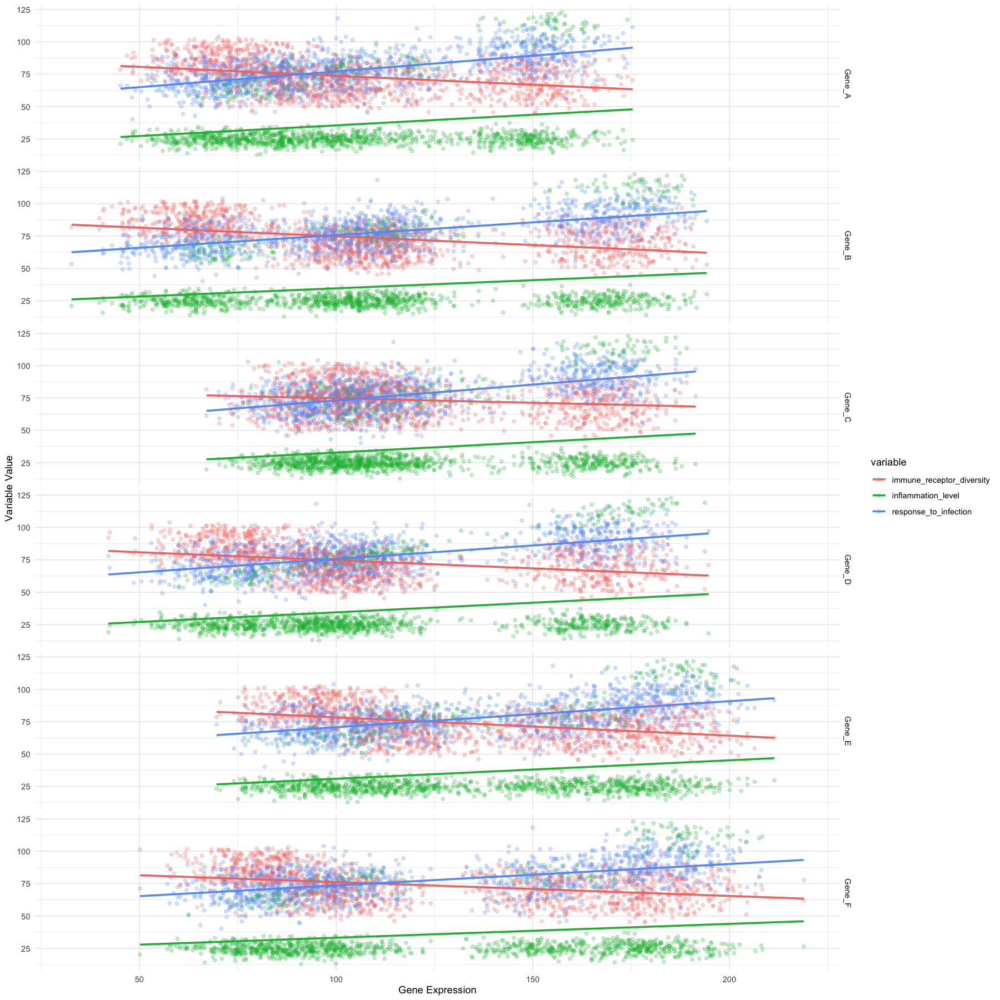

In [225]:
options(repr.plot.width=15, repr.plot.height=15)

ggplot(sharks_immune, aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression")

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


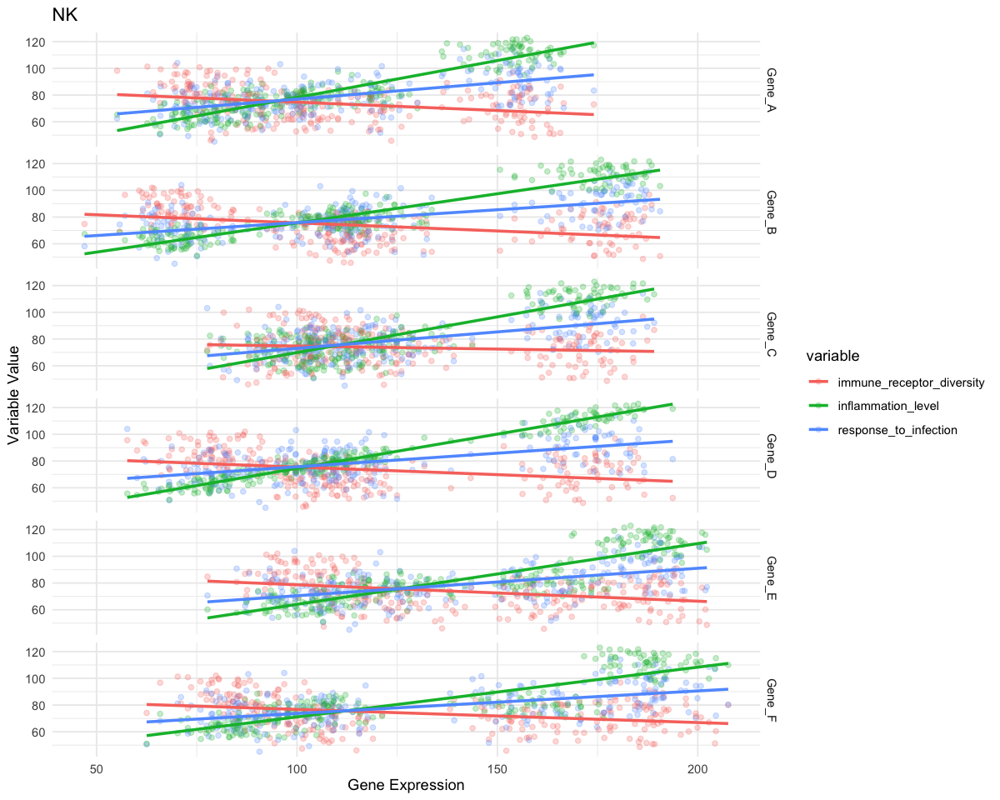

`geom_smooth()` using formula = 'y ~ x'


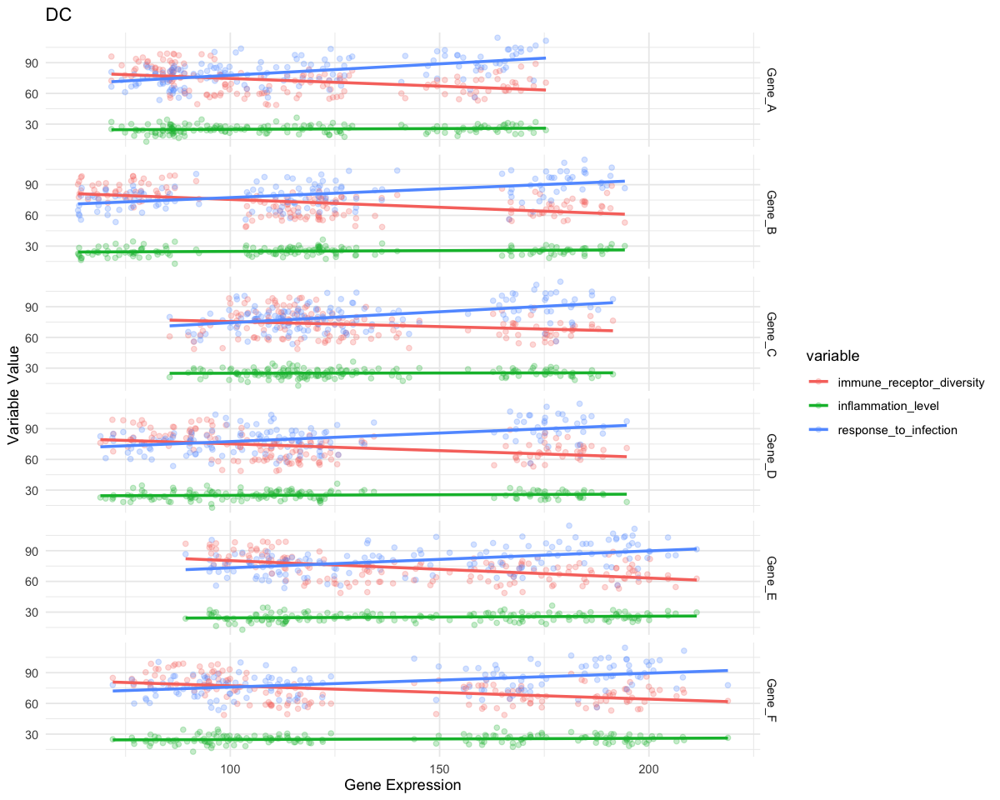

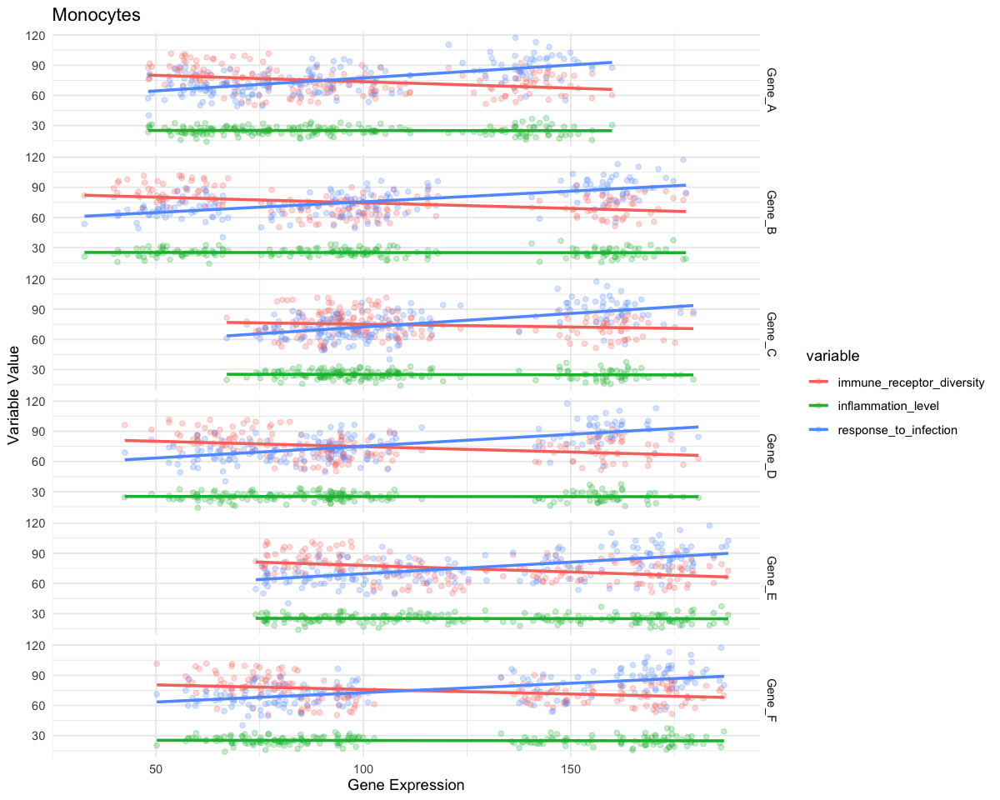

In [231]:
options(repr.plot.width=10, repr.plot.height=8)

ggplot(cell_data(sharks_immune,"NK_cells"), aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression") +
  ggtitle("NK")

ggplot(cell_data(sharks_immune,"Dendritic_cells"), aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression") +
  ggtitle("DC")

ggplot(cell_data(sharks_immune,"Monocytes"), aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression") +
  ggtitle("Monocytes")

In [226]:
sharks_revit <- sharks %>%
  select(physiological_condition, immune_cell_type, Gene_A, Gene_B, Gene_C, Gene_D, Gene_E, Gene_F, regeneration_capacity, resilience_score, reproduction_rate) %>% 
  pivot_longer(cols = -c("physiological_condition","immune_cell_type","Gene_A","Gene_B","Gene_C","Gene_D","Gene_E","Gene_F"), names_to = "variable", values_to = "value") %>%
    select(physiological_condition, immune_cell_type, Gene_A, Gene_B, Gene_C, Gene_D, Gene_E, Gene_F,variable,value) %>% 
    pivot_longer(cols = -c("physiological_condition", "immune_cell_type","variable","value"), names_to = "gene", values_to = "expression")
head(sharks_revit)
names(sharks_revit)

physiological_condition,immune_cell_type,variable,value,gene,expression
<fct>,<chr>,<chr>,<dbl>,<chr>,<dbl>
Infected,Monocytes,regeneration_capacity,126.9,Gene_A,144.7960
Infected,Monocytes,regeneration_capacity,126.9,Gene_B,171.1046
Infected,Monocytes,regeneration_capacity,126.9,Gene_C,162.1400
Infected,Monocytes,regeneration_capacity,126.9,Gene_D,158.4442
Infected,Monocytes,regeneration_capacity,126.9,Gene_E,171.3381
Infected,Monocytes,regeneration_capacity,126.9,Gene_F,168.4784


[1] "physiological_condition" "immune_cell_type"       
[3] "variable"                "value"                  
[5] "gene"                    "expression"

`geom_smooth()` using formula = 'y ~ x'


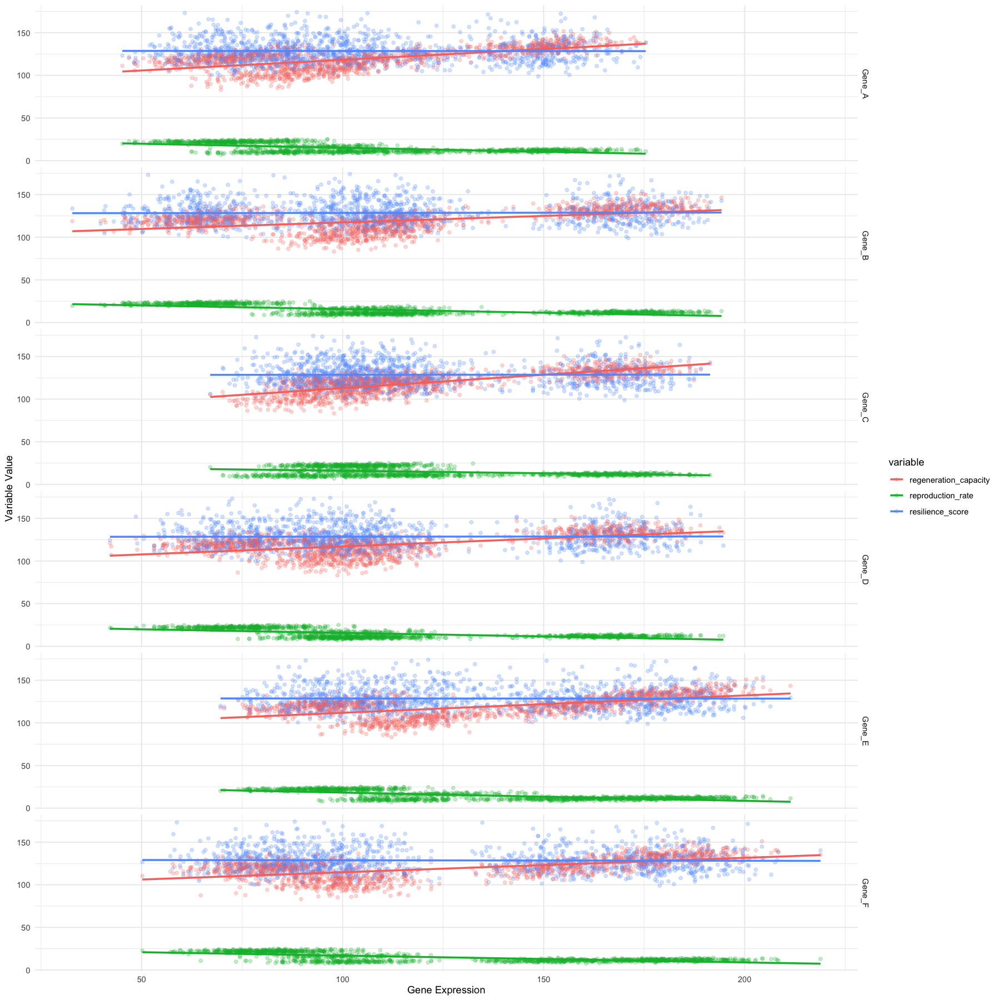

In [227]:
options(repr.plot.width=15, repr.plot.height=15)

ggplot(sharks_revit, aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression")

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


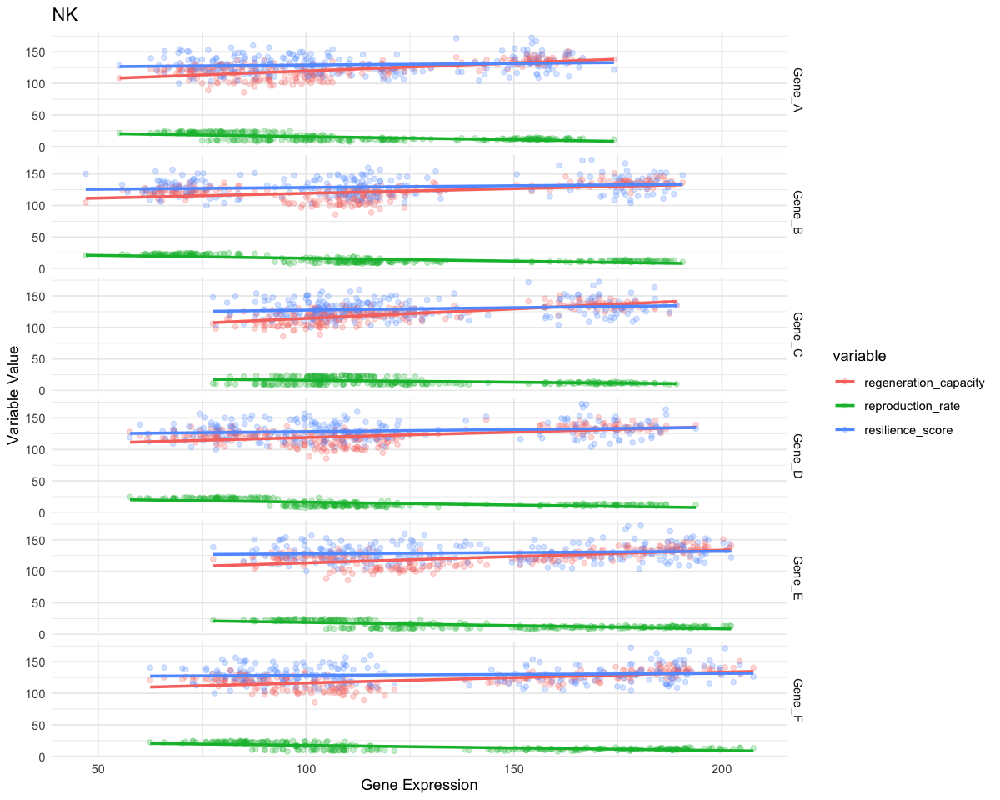

`geom_smooth()` using formula = 'y ~ x'


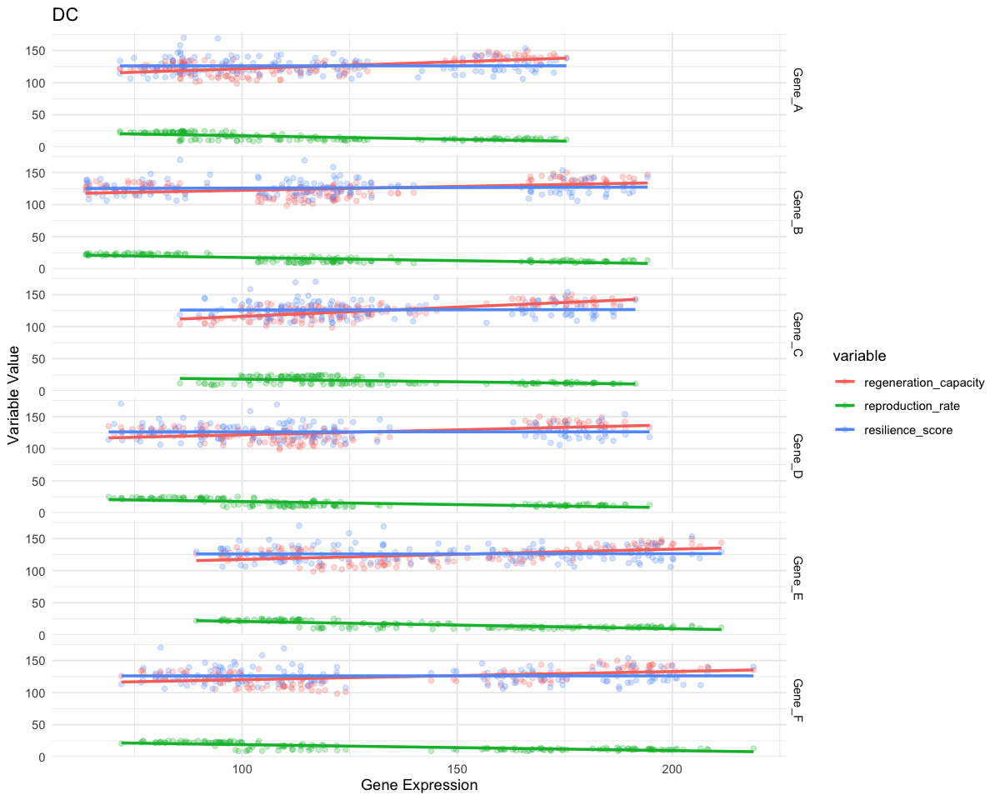

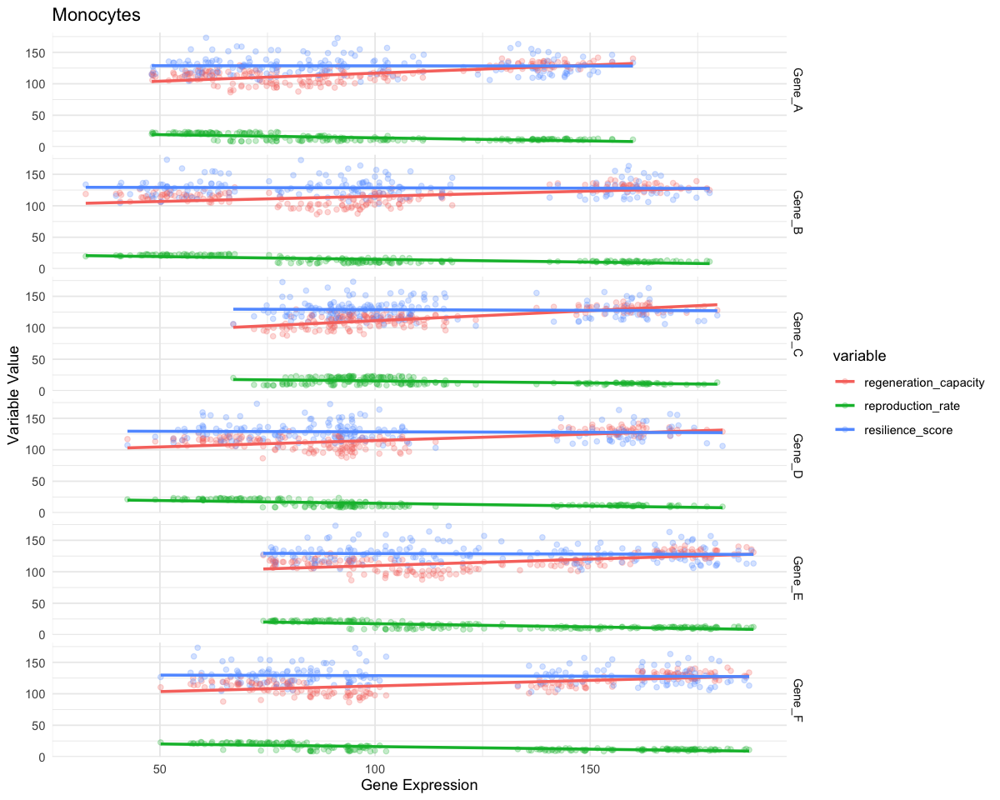

In [233]:
options(repr.plot.width=10, repr.plot.height=8)

ggplot(cell_data(sharks_revit,"NK_cells"), aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression") +
  ggtitle("NK")

ggplot(cell_data(sharks_revit,"Dendritic_cells"), aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression") +
  ggtitle("DC")

ggplot(cell_data(sharks_revit,"Monocytes"), aes(x = expression, y = value, color = variable)) +
  geom_point(alpha=0.25, fill=NA) +
  geom_smooth(method = "lm", se = FALSE) +
  facet_grid(rows=vars(gene)) +
  theme_minimal() +
  labs(y = "Variable Value", x = "Gene Expression") +
  ggtitle("Monocytes")